IMPORTACIÓN DE LIBRERÍAS NECESARIAS

In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [10]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# SPOTIFY: PREDICCIONES Y TENDENCIAS MUSICALES

## ABSTRACTO

### La música en formato digital ha adquirido en los últimos años un crecimiento exponencial en su distribución y está impulsada cada vez más por mecanismos automatizados que capturan, clasifican y analizan continuamente grandes cantidades de datos. En este trabajo se buscará gestionar esos datos desde un punto de vista estadístico, y así sugerir herramientas de este tipo para el análisis de los datos.
### Se presta especial atención a variables como la popularidad de las canciones y al índice de “bailabilidad” de las mismas, con el objetivo de poder estimar ciertos patrones de concordancia y tendencias de las nuevas canciones con respecto a las clásicas.


## INTRODUCCIÓN

### La música juega un papel importante en la vida cotidiana de las personas, y con la digitalización se forman grandes colecciones de datos musicales, que tienden a ser acumuladas aún más por los amantes de la música.
### Las estrategias de minería de datos suelen basarse en dos problemas principales: el tipo de datos disponibles y el uso que se quiere hacer de ellos. ¿Qué tipo de datos es la música? Una colección de pistas de música consta de varios tipos de datos; por ejemplo, los datos pueden consistir en archivos de audio de música o metadatos como el título de la pista y el nombre del artista. ¿Qué tipo de análisis se puede realizar? La minería de datos musicales proporciona métodos específicos para responder a las preguntas más variadas: por ejemplo, clasificación de género, identificación de artistas/cantantes, detección de estado de ánimo/emociones, reconocimiento de instrumentos, búsqueda de similitudes musicales, síntesis musical, etc.
### Este trabajo busca analizar la relación entre las características de audio de los datos de canciones obtenidos de la base de datos de Spotify y la popularidad de la canción, medida por la cantidad de reproducciones que tiene una canción en Spotify. Investigaciones anteriores sobre el tema de la predicción del éxito de nuevos productos han identificado múltiples enfoques para responder a esta pregunta. Además, el cuerpo de investigación existente que define muchos modelos de predicción de popularidad enfatiza la complejidad de los mecanismos de popularidad de las canciones.
### Se buscará predecir si ciertas características de audio como el volumen, la duración y la simplicidad armónica se correlacionan con la evolución de las tendencias musicales.

## PREGUNTAS E HIPÓTESIS
### Algunas de las preguntas que se busca clarificar con la confección del siguiente trabajo son:
- ¿Qué tipo de estilos musicales suelen aparecer en Spotify? 
- ¿Las listas de canciones más populares siguen algún tipo de tendencia?
- ¿Es una tendencia que las canciones sean cada vez más “bailables”?
- ¿La música que se presenta a menudo es más acústica o tendiente a ser más “chill”?
- ¿Cuáles son los tipos de música que podríamos disfrutar?


## SOBRE EL DATASET

### CONTEXTO ANALITICO
#### El Dataset con el que se trabajará a continuación corresponde a un conjunto de datos referidos a canciones encontradas en la plataforma de música digital Spotify, las cuales poseen una gran variedad de géneros musicales.
#### El archivo .csv utilizado fue descargado de la página kaggle.com.


### CONTEXTO COMERCIAL
#### El objetivo del presente trabajo es analizar la relación entre las características de audio de canciones obtenidos de la base de datos de Spotify y la popularidad de la canción, medida por la cantidad de reproducciones que tiene una canción en Spotify. También poder determinar si existe cierta tendencia en los últimos años en dar mayor popularidad y éxito a determinados géneros musicales.


### DESCRIPCIÓN DEL DATASET:

- track_id: El ID de Spotify para la canción
- artists: Los nombres de los artistas que interpretaron la canción. Si hay más de un artista, se separan con un ;
- album_name: El nombre del álbum en el que aparece la canción
- track_name: Nombre de la canción
- popularity: La popularidad de una canción es un valor entre 0 y 100, siendo 100 la más popular. La popularidad se calcula mediante un algoritmo y se basa, en su mayor parte, en el número total de reproducciones que ha tenido la canción y cuán recientes son esas reproducciones. En términos generales, las canciones que se tocan y reproducen mucho ahora tendrán una mayor popularidad que las canciones que se tocaban mucho en el pasado. Las canciones duplicadas (por ejemplo, la misma canción de un sencillo y un álbum) se clasifican de forma independiente. La popularidad del artista y del álbum se deriva matemáticamente de la popularidad de la canción.
- duration_ms: la duración de la canción en milisegundos
- explicit: si la canción tiene letras explícitas o no (verdadero = sí, falso = no, no O desconocido)
- danceability: la “bailabilidad” describe qué tan adecuada es una canción para bailar en función de una combinación de elementos musicales que incluyen tempo, estabilidad del ritmo, fuerza del ritmo y regularidad general. Un valor de 0,0 es menos bailable y 1,0 es más bailable
- energy: La energía es una medida de 0,0 a 1,0 y representa una medida perceptible de intensidad y actividad. Por lo general, las canciones enérgicas se sienten rápidas, fuertes y ruidosas. Por ejemplo, el death metal tiene mucha energía, mientras que un preludio de Bach puntúa bajo en la escala.
- key: La clave en la que se encuentra la canción. Los números enteros se asignan a tonos utilizando la notación estándar de clase de tono. P.ej. 0 = C, 1 = C♯/D♭, 2 = D, y así sucesivamente. Si no se detectó ninguna clave, el valor es -1
- loudness: el volumen general de una canción en decibeles (dB)
- mode: indica la modalidad (mayor o menor) de una canción, el tipo de escala de la que se deriva su contenido melódico. Mayor está representado por 1 y menor es 0
- speechiness: detecta la presencia de palabras habladas en una canción. Cuanto más parecida a la voz sea la grabación (por ejemplo, programa de entrevistas, audiolibro, poesía), más cerca de 1,0 será el valor del atributo. Los valores superiores a 0,66 describen canciones que probablemente estén formadas en su totalidad por palabras habladas. Los valores entre 0,33 y 0,66 describen canciones que pueden contener tanto música como voz, ya sea en secciones o en capas, incluidos casos como la música rap. Los valores por debajo de 0,33 probablemente representen música y otras canciones que no sean de voz.
- acousticness: una medida de confianza de 0,0 a 1,0 de si la canción es acústica. 1.0 representa una alta confianza en que la canción es acústica
- instrumentalness: predice si una canción no contiene voces. Los sonidos "Ooh" y "aah" se tratan como instrumentales en este contexto. Las canciones de rap o de palabras habladas son claramente "vocales". Cuanto más cerca esté el valor de instrumentalidad de 1,0, mayor será la probabilidad de que la canción no contenga contenido vocal.
- liveness: Detecta la presencia de una audiencia en la grabación. Los valores de vivacidad más altos representan una mayor probabilidad de que la canción se interprete en vivo. Un valor por encima de 0,8 proporciona una gran probabilidad de que la canción esté en vivo
- valence: Una medida de 0.0 a 1.0 que describe la positividad musical transmitida por una canción. Las canciones con una valencia alta suenan más positivas (p. ej., felices, alegres, eufóricas), mientras que las canciones con una valencia baja suenan más negativas (p. ej., tristes, deprimidas, enojadas).
- tempo: el tempo general estimado de una canción en pulsaciones por minuto (BPM). En terminología musical, el tempo es la velocidad o ritmo de una pieza dada y se deriva directamente de la duración promedio del tiempo.
- time_signature: una firma de tiempo estimada. El compás (medidor) es una convención de notación para especificar cuántos tiempos hay en cada compás (o compás). El compás varía de 3 a 7, lo que indica compases de 3/4 a 7/4.
- track_genre: el género al que pertenece la canción


In [11]:
pd.read_csv('../data/raw/spotify.csv')



,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,...,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,...,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,...,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,...,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [12]:
data = pd.read_csv('../data/raw/spotify.csv')
data

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,...,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,...,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,...,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,...,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


# EXPLORATORY DATA ANALYSIS (EDA)

#### El Dataset cuenta con 114000 filas y 21 columnas

### Se crea una nueva función llamada "df" en la cual se busca eliminar la columna denominada "Unnamed"

In [13]:
df = data.drop("Unnamed: 0", axis=1) 

In [14]:
df = df.rename(columns = {'duration_ms': 'duration'})
df['duration'] = df['duration']/60000
df.head()

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,3.844433,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,2.493500,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,3.513767,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,3.365550,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,3.314217,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [15]:
df.isna().sum() ## Chequeo de valores nulos

track_id            0
artists             1
album_name          1
track_name          1
popularity          0
duration            0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [16]:
df = df.dropna() ## Eliminación de valores nulos

In [17]:
df.isna().sum() ## Re chequeo de valores nulos

track_id            0
artists             0
album_name          0
track_name          0
popularity          0
duration            0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [18]:
df = df.drop_duplicates() ## Eliminación de valores duplicados

### Información de las variables que componen el Dataset

In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113549 entries, 0 to 113999
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   track_id          113549 non-null  object 
 1   artists           113549 non-null  object 
 2   album_name        113549 non-null  object 
 3   track_name        113549 non-null  object 
 4   popularity        113549 non-null  int64  
 5   duration          113549 non-null  float64
 6   explicit          113549 non-null  bool   
 7   danceability      113549 non-null  float64
 8   energy            113549 non-null  float64
 9   key               113549 non-null  int64  
 10  loudness          113549 non-null  float64
 11  mode              113549 non-null  int64  
 12  speechiness       113549 non-null  float64
 13  acousticness      113549 non-null  float64
 14  instrumentalness  113549 non-null  float64
 15  liveness          113549 non-null  float64
 16  valence           11

In [20]:
df.shape

(113549, 20)

#### El Dataset modificado cuenta con 113549 filas y 20 columnas

### Las columnas que contiene el Dataset son las siguientes:

In [21]:
df.columns

Index(['track_id', 'artists', 'album_name', 'track_name', 'popularity',
       'duration', 'explicit', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature', 'track_genre'],
      dtype='object')

In [22]:
df.count()

track_id            113549
artists             113549
album_name          113549
track_name          113549
popularity          113549
duration            113549
explicit            113549
danceability        113549
energy              113549
key                 113549
loudness            113549
mode                113549
speechiness         113549
acousticness        113549
instrumentalness    113549
liveness            113549
valence             113549
tempo               113549
time_signature      113549
track_genre         113549
dtype: int64

In [23]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
popularity,113549.0,33.324433,22.283855,0.0000,17.000000,35.000000,50.0000,100.00000
duration,113549.0,3.801356,1.773552,0.1431,2.903067,3.550000,4.3598,87.28825
danceability,113549.0,0.567031,0.173409,0.0000,0.456000,0.580000,0.6950,0.98500
energy,113549.0,0.642091,0.251053,0.0000,0.473000,0.685000,0.8540,1.00000
key,113549.0,5.309452,3.560147,0.0000,2.000000,5.000000,8.0000,11.00000
loudness,113549.0,-8.243408,5.011422,-49.5310,-9.998000,-6.997000,-5.0010,4.53200
mode,113549.0,0.637866,0.480620,0.0000,0.000000,1.000000,1.0000,1.00000
speechiness,113549.0,0.084674,0.105762,0.0000,0.035900,0.048900,0.0845,0.96500
acousticness,113549.0,0.314064,0.331906,0.0000,0.016800,0.168000,0.5960,0.99600
instrumentalness,113549.0,0.155703,0.309217,0.0000,0.000000,0.000041,0.0487,1.00000


# ANALISIS DE VARIABLES NUMERICAS

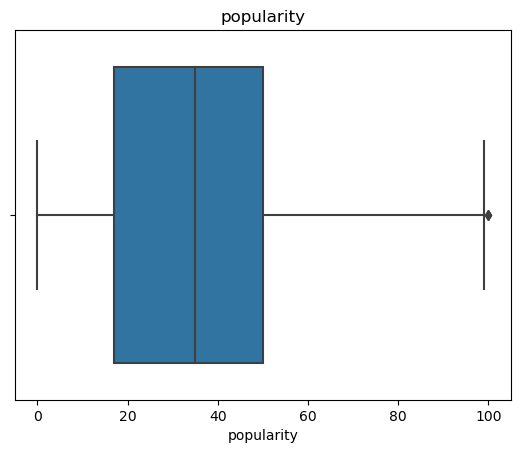

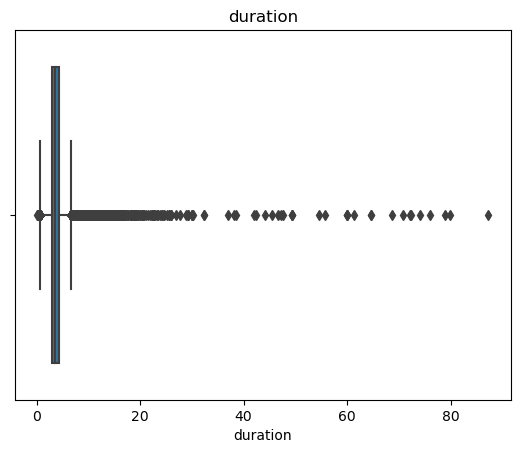

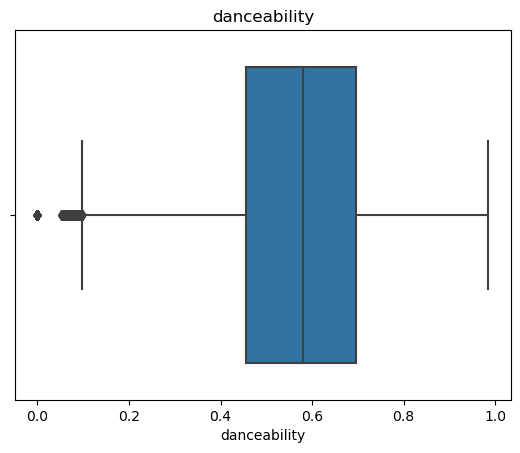

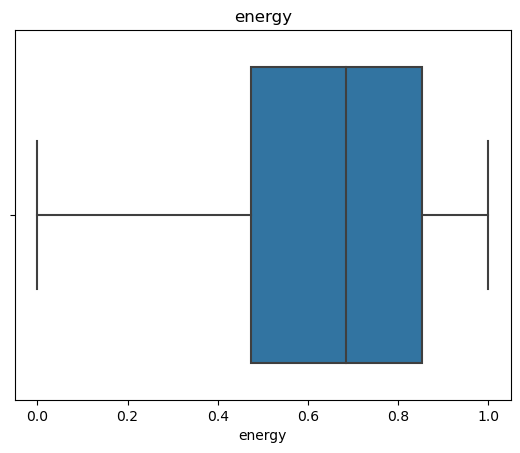

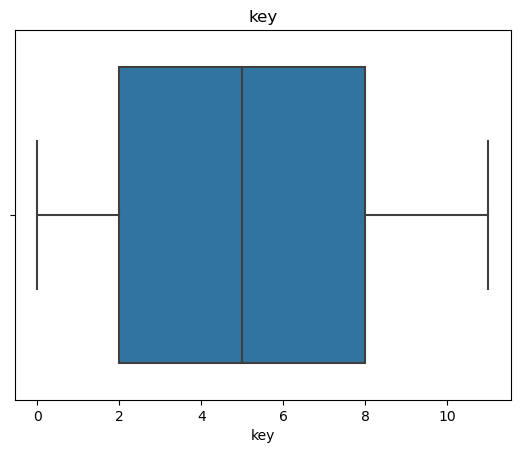

...

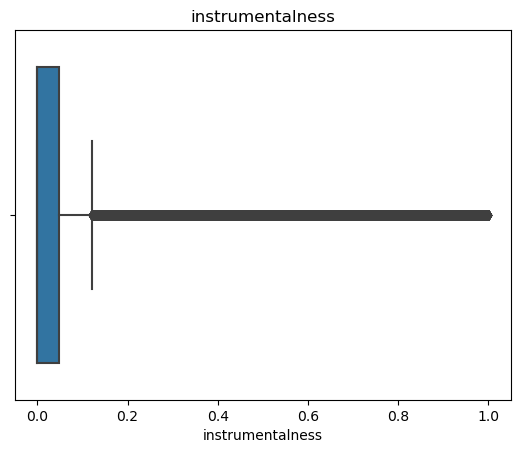

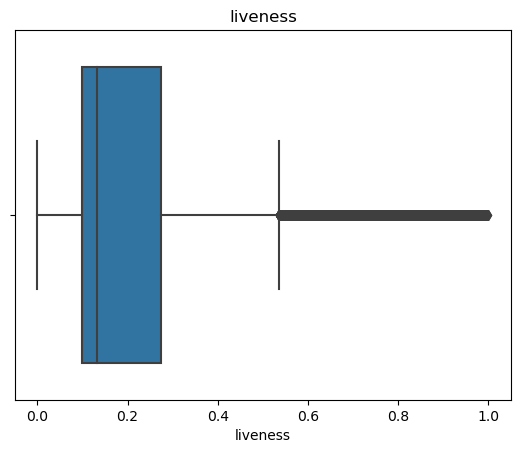

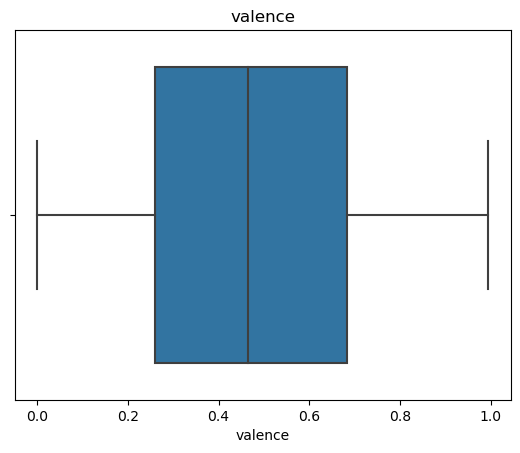

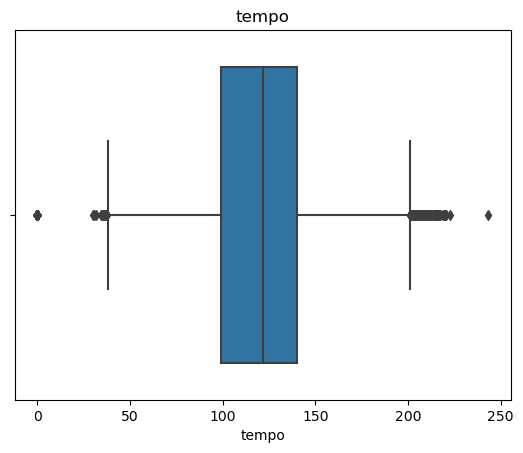

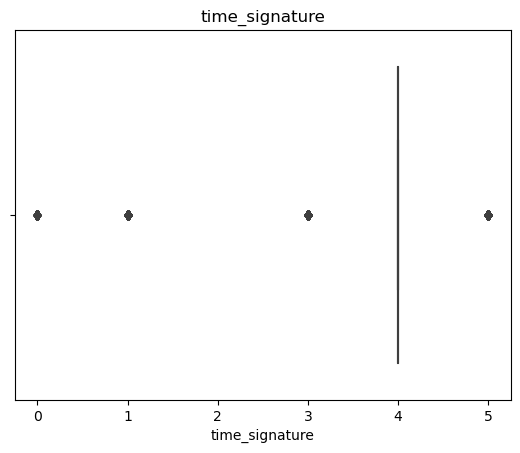

In [24]:
cols_num = ['popularity', 'duration', 'danceability', 'energy',
            'key', 'loudness', 'mode', 'speechiness', 'acousticness',
            'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']

# Se generan boxplots individuales para cada variable numérica
for col in cols_num:
    plt.figure()
    sns.boxplot(x=df[col])
    plt.title(col)
    plt.show()

## POPULARITY

In [25]:
fig = px.scatter(df, y='popularity', width=1200, height=350)
fig.show()

In [26]:
fig = px.histogram(df, x='popularity', width=800, height=400)
fig.show()

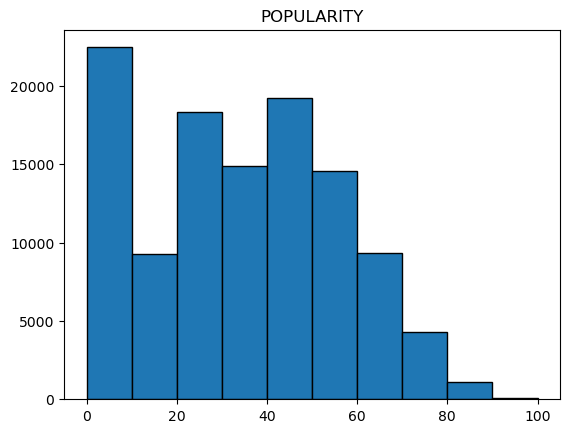

In [27]:
plt.title('POPULARITY')
plt.hist(df["popularity"], edgecolor = 'black', linewidth=1)
plt.show()

In [28]:
popularity = df["popularity"]

media = np.mean(popularity)
mediana = np.median(popularity)
desviacion_estandar = np.std(popularity)
asimetria_pearson = 3 * (media - mediana) / desviacion_estandar
asimetria_fisher = np.sum((popularity - media) ** 3) / (len(popularity) * desviacion_estandar ** 3)

print("Asimetría de Pearson:", asimetria_pearson)
print("Asimetría de Fisher:", asimetria_fisher)

Asimetría de Pearson: -0.22557696203458458
Asimetría de Fisher: 0.042228099481121384


#### El valor obtenido para la asimetría de Pearson es aproximadamente -0.2256. Al ser negativo, indica una ligera asimetría hacia la izquierda o una cola más pronunciada en ese lado. Sin embargo, el valor absoluto es relativamente pequeño, lo que sugiere que la asimetría no es muy pronunciada.
#### El valor obtenido para la asimetría de Fisher es aproximadamente 0.0422, al ser cercano a cero, sugiere que la distribución "popularity" es relativamente simétrica.

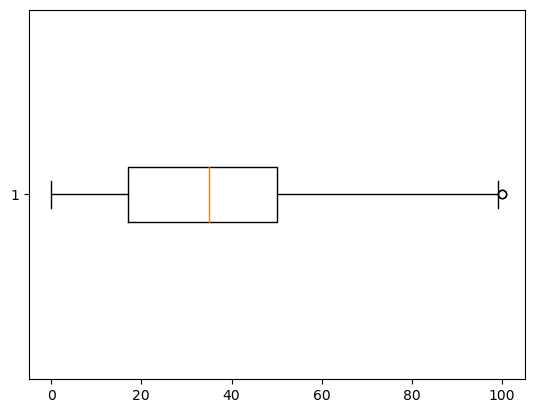

In [29]:
plt.boxplot(df["popularity"], vert=False)
plt.show()

In [30]:
Q1 = df['popularity'].quantile(0.25)
print ("Primer Cuartil", Q1)

Q3 = df['popularity'].quantile(0.75)
print ("Tercer Cuartil", Q3)

IQR = Q3 - Q1
print ("Rango Intercuartil", IQR)

Mediana = df['popularity'].median()
print ("Mediana", Mediana)

Valor_Minimo = df['popularity'].min()
print ("Valor Mínimo", Valor_Minimo)

Valor_Maximo = df['popularity'].max()
print ("Valor Máximo", Valor_Maximo)

Primer Cuartil 17.0
Tercer Cuartil 50.0
Rango Intercuartil 33.0
Mediana 35.0
Valor Mínimo 0
Valor Máximo 100


In [31]:
Big_Inf = (Q1 - 1.5 * IQR)
print ("Bigote Inferior \n", Big_Inf)

Big_Sup = (Q3 + 1.5 * IQR)
print ("Bigote Superior \n", Big_Sup)

Bigote Inferior 
 -32.5
Bigote Superior 
 99.5


In [32]:
Ubicacion_outliers = (df['popularity'] < Big_Inf) | (df['popularity'] > Big_Sup)
print ("\n Ubicación de Outliers \n", Ubicacion_outliers)


 Ubicación de Outliers 
 0         False
1         False
2         False
3         False
4         False
          ...  
113995    False
113996    False
113997    False
113998    False
113999    False
Name: popularity, Length: 113549, dtype: bool


In [33]:
outliers = df[Ubicacion_outliers]
print ("\n Lista de Outliers \n", outliers)


 Lista de Outliers 
                      track_id               artists  \
20001  3nqQXoyQOWXiESFLlDF1hG  Sam Smith;Kim Petras   
81051  3nqQXoyQOWXiESFLlDF1hG  Sam Smith;Kim Petras   

                      album_name                 track_name  popularity  \
20001  Unholy (feat. Kim Petras)  Unholy (feat. Kim Petras)         100   
81051  Unholy (feat. Kim Petras)  Unholy (feat. Kim Petras)         100   

       duration  explicit  danceability  energy  key  loudness  mode  \
20001  2.615717     False         0.714   0.472    2    -7.375     1   
81051  2.615717     False         0.714   0.472    2    -7.375     1   

       speechiness  acousticness  instrumentalness  liveness  valence  \
20001       0.0864         0.013          0.000005     0.266    0.238   
81051       0.0864         0.013          0.000005     0.266    0.238   

         tempo  time_signature track_genre  
20001  131.121               4       dance  
81051  131.121               4         pop  


In [34]:
outliers_ordenados = outliers.sort_values("popularity")
outliers_ordenados

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
20001,3nqQXoyQOWXiESFLlDF1hG,Sam Smith;Kim Petras,Unholy (feat. Kim Petras),Unholy (feat. Kim Petras),100,2.615717,False,0.714,0.472,2,-7.375,1,0.0864,0.013,0.000005,0.266,0.238,131.121,4,dance
81051,3nqQXoyQOWXiESFLlDF1hG,Sam Smith;Kim Petras,Unholy (feat. Kim Petras),Unholy (feat. Kim Petras),100,2.615717,False,0.714,0.472,2,-7.375,1,0.0864,0.013,0.000005,0.266,0.238,131.121,4,pop


In [35]:
Ubicacion_sin_outliers = (df['popularity'] >= Big_Inf) & (df['popularity'] <= Big_Sup)
df_2 = df[Ubicacion_sin_outliers]
df_2

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,3.844433,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,2.493500,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,3.513767,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,3.365550,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,3.314217,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,6.416650,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,6.416667,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,4.524433,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,4.731550,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [36]:
df_2.count()

track_id            113547
artists             113547
album_name          113547
track_name          113547
popularity          113547
duration            113547
explicit            113547
danceability        113547
energy              113547
key                 113547
loudness            113547
mode                113547
speechiness         113547
acousticness        113547
instrumentalness    113547
liveness            113547
valence             113547
tempo               113547
time_signature      113547
track_genre         113547
dtype: int64

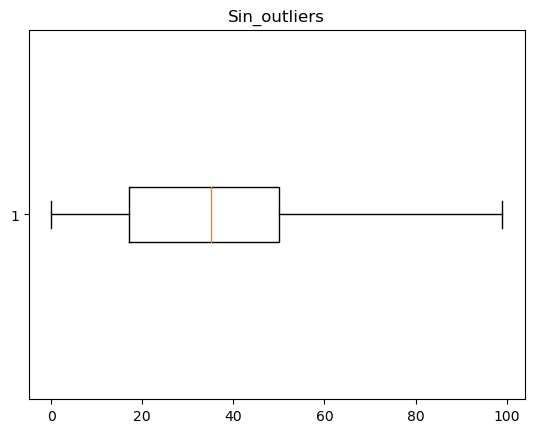

In [37]:
plt.title("Sin_outliers")
plt.boxplot(df_2["popularity"], vert=False)
plt.show()

In [38]:
df_2.describe().T

,count,mean,std,min,25%,50%,75%,max
popularity,113547.0,33.323258,22.282294,0.0000,17.0000,35.000000,50.000000,99.00000
duration,113547.0,3.801377,1.773560,0.1431,2.9031,3.550000,4.359867,87.28825
danceability,113547.0,0.567029,0.173410,0.0000,0.4560,0.580000,0.695000,0.98500
energy,113547.0,0.642094,0.251054,0.0000,0.4730,0.685000,0.854000,1.00000
key,113547.0,5.309511,3.560151,0.0000,2.0000,5.000000,8.000000,11.00000
loudness,113547.0,-8.243423,5.011464,-49.5310,-9.9980,-6.997000,-5.001000,4.53200
mode,113547.0,0.637859,0.480621,0.0000,0.0000,1.000000,1.000000,1.00000
speechiness,113547.0,0.084674,0.105763,0.0000,0.0359,0.048900,0.084500,0.96500
acousticness,113547.0,0.314069,0.331907,0.0000,0.0168,0.168000,0.596000,0.99600
instrumentalness,113547.0,0.155706,0.309219,0.0000,0.0000,0.000041,0.048700,1.00000


## DURATION

In [39]:
fig = px.scatter(df_2, y='duration', width=1200, height=350)
fig.show()

In [40]:
fig = px.histogram(df_2, x='duration', width=800, height=400)
fig.show()

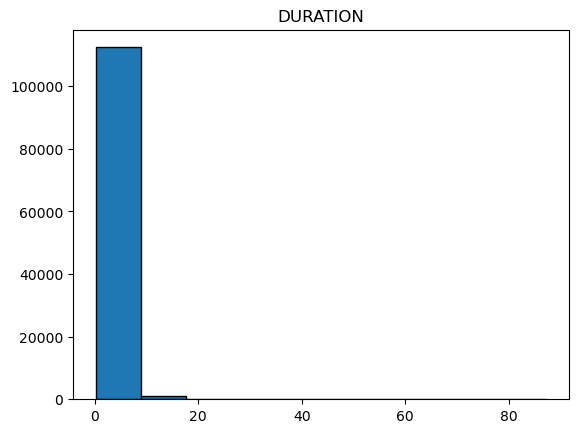

In [41]:
plt.title('DURATION')
plt.hist(df_2["duration"], edgecolor = 'black', linewidth=1)
plt.show()

In [42]:
duration = df_2["duration"]

media = np.mean(duration)
mediana = np.median(duration)
desviacion_estandar = np.std(duration)
asimetria_pearson = 3 * (media - mediana) / desviacion_estandar
asimetria_fisher = np.sum((duration - media) ** 3) / (len(duration) * desviacion_estandar ** 3)

print("Asimetría de Pearson:", asimetria_pearson)
print("Asimetría de Fisher:", asimetria_fisher)

Asimetría de Pearson: 0.4252094062516276
Asimetría de Fisher: 10.814436395704256


#### La asimetría de Pearson es 0.4252094062516276, lo que sugiere una ligera cola hacia la derecha en la distribución.
#### La asimetría de Fisher es 10.814436395704256, lo que indica un sesgo positivo bastante pronunciado hacia la derecha en la distribución.

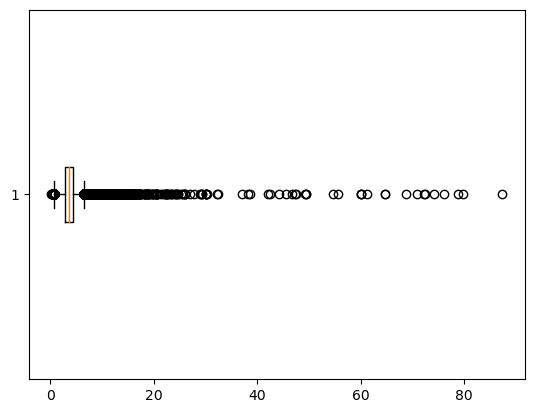

In [43]:
plt.boxplot(df_2["duration"], vert=False)
plt.show()

In [44]:
Q1 = df_2['duration'].quantile(0.25)
print ("Primer Cuartil", Q1)

Q3 = df_2['duration'].quantile(0.75)
print ("Tercer Cuartil", Q3)

IQR = Q3 - Q1
print ("Rango Intercuartil", IQR)

Mediana = df_2['duration'].median()
print ("Mediana", Mediana)

Valor_Minimo = df_2['duration'].min()
print ("Valor Mínimo", Valor_Minimo)

Valor_Maximo = df_2['duration'].max()
print ("Valor Máximo", Valor_Maximo)

Primer Cuartil 2.9031
Tercer Cuartil 4.359866666666667
Rango Intercuartil 1.4567666666666672
Mediana 3.55
Valor Mínimo 0.1431
Valor Máximo 87.28825


In [45]:
Big_Inf = (Q1 - 1.5 * IQR)
print ("Bigote Inferior \n", Big_Inf)

Big_Sup = (Q3 + 1.5 * IQR)
print ("Bigote Superior \n", Big_Sup)

Bigote Inferior 
 0.7179499999999988
Bigote Superior 
 6.545016666666668


In [46]:
Ubicacion_outliers = (df_2['duration'] < Big_Inf) | (df_2['duration'] > Big_Sup)
print ("\n Ubicación de Outliers \n", Ubicacion_outliers)


 Ubicación de Outliers 
 0         False
1         False
2         False
3         False
4         False
          ...  
113995    False
113996    False
113997    False
113998    False
113999    False
Name: duration, Length: 113547, dtype: bool


In [47]:
outliers = df_2[Ubicacion_outliers]
print ("\n Lista de Outliers \n", outliers)


 Lista de Outliers 
                       track_id                         artists  \
253     0I0l2Oo5zjpCEphpDJL0Pm                   Motohiro Hata   
650     6ad7bQ48TlqAgebCExUJVe                     Ichiko Aoba   
752     1TRIYxcVJYPki5AX2hZzZT                  Luther Allison   
851     5fomS2mZjvxxJ2iVH3fosc                    John Elliott   
896     0xOIqJadsikka2so1zhghO                      Harley Poe   
...                        ...                             ...   
113932  3Ia4fDeie06NoYMSnoipZV                    Phil Wickham   
113945  5jawyqbfmVufFM2YDS2jdu  Hillsong Worship;Reuben Morgan   
113959  1V0iyVxxWAidx25wcYdzEp                      Housefires   
113969  7mD7yAQm4GcifSnWqJdZHi       Bethel Music;Molly Skaggs   
113988  6PM55W7WiUmHVPdUebJP55                   Planetshakers   

                               album_name  \
253                                   言ノ葉   
650                                     0   
752                    Bad News Is Coming   
851  

In [48]:
outliers_ordenados = outliers.sort_values("duration")
outliers_ordenados

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
59310,6hsyfegVY5yklJneM40mWi,Leila Bela,Angra Manyu,The Exorsism Begins...,0,0.143100,False,0.000,0.0400,8,-29.714,0,0.0000,0.92800,0.956,0.1150,0.0000,0.000,0,iranian
59812,38Ogh3rsHba83kXx13gbKs,Leila Bela,Angra Manyu,V-4,0,0.223100,False,0.000,0.2240,11,-22.196,1,0.0000,0.97000,0.000,0.9070,0.0000,0.000,0,iranian
59775,1HVjSh7scH1PaPiLjy2LEu,Leila Bela;Leila's Opera Class,Angra Manyu,Screams for a Finale! (feat. Leila's Opera Class),0,0.263333,False,0.251,0.5080,5,-10.564,0,0.3160,0.96900,0.999,0.9520,0.0000,184.051,3,iranian
16856,5YKCM3jbJ8lqUXUwfU7KwZ,Wolfgang Amadeus Mozart;Ingrid Haebler,Mozart: The Complete Piano Sonatas,"Andante in C Major, K. 1a",0,0.290883,False,0.467,0.0301,2,-28.518,0,0.0428,0.99500,0.900,0.1240,0.0000,84.375,4,classical
39233,1T5QvLF9lO4HO3OZQbaX9p,Robert Schumann;Pavel Nersessian,"Schumann, Poulenc & Others: Piano Works (Live ...","Carnaval, Op. 9: No. 20, Pause (Live in Japan,...",0,0.297100,False,0.372,0.2780,8,-16.882,1,0.0370,0.98500,0.921,0.1640,0.9120,89.032,1,german
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13344,3gFme8BdfTtFHxKmuTnSbj,Mark Farina,House of OM (DJ Mix),House of Om - Mark Farina - Continuous Mix,11,74.125333,False,0.861,0.8050,11,-6.461,0,0.0711,0.00548,0.577,0.1350,0.5450,129.306,4,chicago-house
73840,6JbQr97EMFD2D3Ek6gxgt1,Loco Dice,Amnesia Ibiza - Underground 10,Amnesia Ibiza Underground 10 DJ Mix,17,76.064950,False,0.783,0.7280,10,-10.176,0,0.0612,0.00158,0.840,0.1580,0.1890,125.044,4,minimal-techno
24348,6wypxnAvmv5zYewUX3VFDd,Seth Troxler,Seth Troxler - The Lab 03,The Lab 03 - Continuous DJ Mix Part 1,8,78.838367,False,0.684,0.6560,5,-11.163,0,0.0633,0.01910,0.848,0.1030,0.3010,123.180,4,detroit-techno
10935,0LBIf9EFHuxmuNig4JHGZo,Timo Maas,Crossing Wires 002 - Compiled And Mixed By Tim...,Crossing Wires 002 - Continuous DJ Mix,11,79.817100,False,0.697,0.6320,1,-12.469,1,0.0451,0.00815,0.871,0.0998,0.1510,121.055,4,breakbeat


In [49]:
Ubicacion_sin_outliers = (df_2['duration'] >= Big_Inf) & (df_2['duration'] <= Big_Sup)
df_3 = df_2[Ubicacion_sin_outliers]
df_3

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,3.844433,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,2.493500,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,3.513767,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,3.365550,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,3.314217,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,6.416650,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,6.416667,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,4.524433,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,4.731550,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [50]:
df_3.count()

track_id            107955
artists             107955
album_name          107955
track_name          107955
popularity          107955
duration            107955
explicit            107955
danceability        107955
energy              107955
key                 107955
loudness            107955
mode                107955
speechiness         107955
acousticness        107955
instrumentalness    107955
liveness            107955
valence             107955
tempo               107955
time_signature      107955
track_genre         107955
dtype: int64

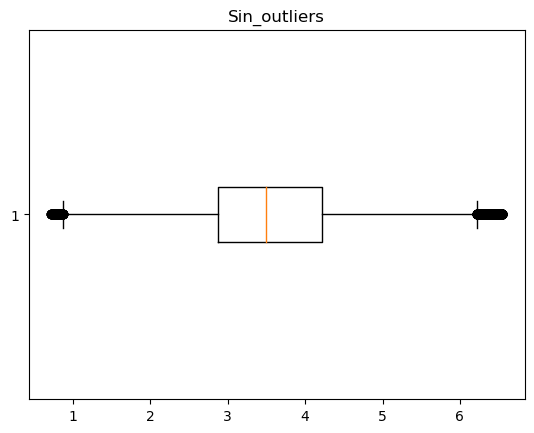

In [51]:
plt.title("Sin_outliers")
plt.boxplot(df_3["duration"], vert=False)
plt.show()

In [52]:
df_3.describe().T

,count,mean,std,min,25%,50%,75%,max
popularity,107955.0,33.588190,22.412867,0.000000,18.0000,35.000000,51.00000,99.000000
duration,107955.0,3.577835,1.060213,0.718883,2.8750,3.499733,4.21310,6.544267
danceability,107955.0,0.568868,0.170565,0.000000,0.4600,0.581000,0.69300,0.985000
energy,107955.0,0.642756,0.250697,0.000000,0.4730,0.686000,0.85400,1.000000
key,107955.0,5.307304,3.560232,0.000000,2.0000,5.000000,8.00000,11.000000
loudness,107955.0,-8.135894,4.969031,-49.531000,-9.8570,-6.895000,-4.93300,4.532000
mode,107955.0,0.639887,0.480035,0.000000,0.0000,1.000000,1.00000,1.000000
speechiness,107955.0,0.084607,0.104440,0.000000,0.0357,0.048800,0.08520,0.963000
acousticness,107955.0,0.317142,0.331355,0.000000,0.0185,0.174000,0.60000,0.996000
instrumentalness,107955.0,0.140430,0.296107,0.000000,0.0000,0.000029,0.02465,1.000000


## DANCEABILITY

In [53]:
fig = px.scatter(df_3, y='danceability', width=1200, height=350)
fig.show()

In [54]:
fig = px.histogram(df_3, x='danceability', width=800, height=400)
fig.show()

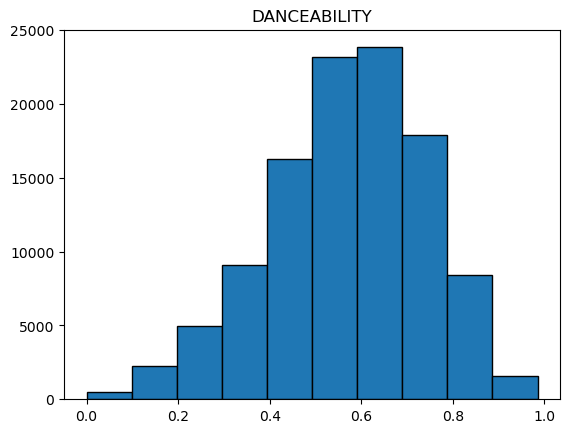

In [55]:
plt.title('DANCEABILITY')
plt.hist(df_3["danceability"], edgecolor = 'black', linewidth=1)
plt.show()

In [56]:
danceability = df_3["danceability"]

media = np.mean(danceability)
mediana = np.median(danceability)
desviacion_estandar = np.std(danceability)
asimetria_pearson = 3 * (media - mediana) / desviacion_estandar
asimetria_fisher = np.sum((danceability - media) ** 3) / (len(danceability) * desviacion_estandar ** 3)

print("Asimetría de Pearson:", asimetria_pearson)
print("Asimetría de Fisher:", asimetria_fisher)

Asimetría de Pearson: -0.2133838636775886
Asimetría de Fisher: -0.39227810358631876


#### El valor de la asimetría de Pearson es -0.2134, lo que indica una ligera asimetría negativa en la distribución de los datos.
#### El valor de la asimetría de Fisher es -0.3923, lo que indica una distribución platicúrtica con colas ligeras y picos bajos.

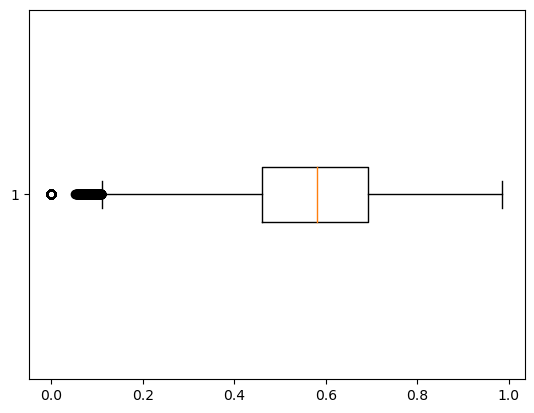

In [57]:
plt.boxplot(df_3["danceability"], vert=False)
plt.show()

In [58]:
Q1 = df_3['danceability'].quantile(0.25)
print ("Primer Cuartil", Q1)

Q3 = df_3['danceability'].quantile(0.75)
print ("Tercer Cuartil", Q3)

IQR = Q3 - Q1
print ("Rango Intercuartil", IQR)

Mediana = df_3['danceability'].median()
print ("Mediana", Mediana)

Valor_Minimo = df_3['danceability'].min()
print ("Valor Mínimo", Valor_Minimo)

Valor_Maximo = df_3['danceability'].max()
print ("Valor Máximo", Valor_Maximo)

Primer Cuartil 0.46
Tercer Cuartil 0.693
Rango Intercuartil 0.23299999999999993
Mediana 0.581
Valor Mínimo 0.0
Valor Máximo 0.985


In [59]:
Big_Inf = (Q1 - 1.5 * IQR)
print ("Bigote Inferior \n", Big_Inf)

Big_Sup = (Q3 + 1.5 * IQR)
print ("Bigote Superior \n", Big_Sup)

Bigote Inferior 
 0.1105000000000001
Bigote Superior 
 1.0425


In [60]:
Ubicacion_outliers = (df_3['danceability'] < Big_Inf) | (df_3['danceability'] > Big_Sup)
print ("\n Ubicación de Outliers \n", Ubicacion_outliers)


 Ubicación de Outliers 
 0         False
1         False
2         False
3         False
4         False
          ...  
113995    False
113996    False
113997    False
113998    False
113999    False
Name: danceability, Length: 107955, dtype: bool


In [61]:
outliers = df_3[Ubicacion_outliers]
print ("\n Lista de Outliers \n", outliers)


 Lista de Outliers 
                       track_id  \
4077    56oReVXIfUO9xkX7pHmEU0   
4090    4r4kqIofeGj6lms3R5m8Y0   
4131    59gg6zQhSKGVnkT3hWAY3l   
4191    5DCNX1F47bDPke1LxKrEnS   
4193    5m7f9709ZRMiiSY2WwNZtM   
...                        ...   
113899  2ctXQ21bZ7ZsCsWnbFIkAp   
113912  1sQzql0UMBfpFWGENPFTTN   
113931  172wTMTSTGKoQ3c3y1dD6A   
113940  3Fj6wu6AAnltIyS2jNbqiG   
113977  3FuOBnk7Xsglp7AIsHQVaA   

                                                  artists  \
4077    Max Richter;Louisa Fuller;Natalia Bonner;John ...   
4090                        Dmitri Shostakovich;Ares Trio   
4131                                Max Richter;Lang Lang   
4191    Peter Gregson;Daniel Pioro;Grace Davidson;Clar...   
4193    Peter Gregson;Daniel Pioro;Grace Davidson;Clar...   
...                                                   ...   
113899                                   Monjes Tibetanos   
113912                                       Thetahealing   
113931              

In [62]:
outliers_ordenados = outliers.sort_values("danceability")
outliers_ordenados

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
101412,3C32S8W8BBBKfHg3qyNX7E,White Noise Therapy,Pink Noise,Smooth Sailing,38,6.000000,False,0.00,0.00002,2,-16.555,1,0.0000,0.951000,0.873000,0.1130,0.0000,0.000,0,sleep
101522,33wp91bmIk1XYn7aKxMone,"Spa;Spa, Relaxation and Dreams;Relax Meditate ...",White Noise Spa Collection - 50 Shades of Ambi...,Clean White Noise,35,1.210850,False,0.00,0.00002,9,-8.327,1,0.0000,0.112000,0.331000,0.6630,0.0000,0.000,0,sleep
101065,3IVQzOYO8JG9Lj41pq98Pf,Weißes Rauschen HD,Weißer Lärm Baby Schlaf (Meeresrauschen),Neugeborene Schlafhilfe,50,3.332150,False,0.00,0.39800,2,-16.889,0,0.0000,0.795000,0.979000,0.9310,0.0000,0.000,0,sleep
101515,7Fta9aJyI2O8lZ7OZ4qwmS,Silent Knights,White Noise Hoover,Calm Hoover Noise,36,2.133333,False,0.00,0.00048,6,-9.423,1,0.0000,0.124000,0.992000,0.9090,0.0000,0.000,0,sleep
101513,3jpY2gUd3DOnDr4WPuMRHx,Deep Sleep;Relaxation And Meditation;Relax;Ont...,White Noise Collection,Pure Brown Noise - Loopable with No Fade,36,1.189950,False,0.00,0.00002,10,-17.502,0,0.0000,0.000000,0.124000,0.6880,0.0000,0.000,0,sleep
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6675,1t1trD4LtJ2U3n8dzQAoR2,Marduk,Here's No Peace,Woman of Dark Desires,17,4.503550,False,0.11,0.97200,8,-5.783,0,0.0719,0.000003,0.000017,0.2960,0.1560,174.131,4,black-metal
36448,671FtednpnMTgU26wryBl6,Jacques Offenbach;Nemanja Radulović;Camille Th...,Offenbach - Great Recordings,Les Contes d'Hoffmann / Act III: Barcarolle (A...,34,3.366000,False,0.11,0.02990,2,-22.969,1,0.0426,0.970000,0.778000,0.1020,0.0543,167.214,4,french
4413,51wV3bwTnQMNe4lZHiacGs,Ilya Beshevli,Deja Vu,Compassion,51,3.108667,False,0.11,0.26600,0,-14.371,0,0.0411,0.618000,0.917000,0.1430,0.1340,83.607,4,ambient
39257,5xou5JGquouUhzQQIZDkUb,Hans Zimmer;Adam Lukas;James Everingham;AURORA,Frozen Planet II (Original Television Soundtrack),Harp Seal Pup,34,5.231550,False,0.11,0.11200,5,-22.858,1,0.0406,0.922000,0.648000,0.0792,0.0384,83.290,4,german


In [63]:
Ubicacion_sin_outliers = (df_3['danceability'] >= Big_Inf) & (df_3['danceability'] <= Big_Sup)
df_4 = df_3[Ubicacion_sin_outliers]
df_4

,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,3.844433,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,2.493500,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,3.513767,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,3.365550,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,3.314217,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,6.416650,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,6.416667,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,4.524433,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,4.731550,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [64]:
df_4.count()

track_id            107309
artists             107309
album_name          107309
track_name          107309
popularity          107309
duration            107309
explicit            107309
danceability        107309
energy              107309
key                 107309
loudness            107309
mode                107309
speechiness         107309
acousticness        107309
instrumentalness    107309
liveness            107309
valence             107309
tempo               107309
time_signature      107309
track_genre         107309
dtype: int64

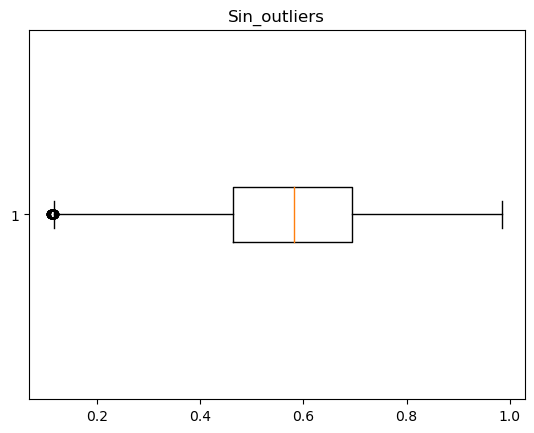

In [65]:
plt.title("Sin_outliers")
plt.boxplot(df_4["danceability"], vert=False)
plt.show()

In [66]:
df_4.describe().T

,count,mean,std,min,25%,50%,75%,max
popularity,107309.0,33.615652,22.429019,0.000000,18.000000,35.000000,51.000000,99.000000
duration,107309.0,3.579313,1.056728,0.718883,2.878567,3.500000,4.212217,6.544267
danceability,107309.0,0.571891,0.166527,0.111000,0.463000,0.582000,0.694000,0.985000
energy,107309.0,0.644821,0.248574,0.000020,0.476000,0.687000,0.855000,1.000000
key,107309.0,5.310747,3.559491,0.000000,2.000000,5.000000,8.000000,11.000000
loudness,107309.0,-8.063722,4.842237,-46.591000,-9.795000,-6.873000,-4.924000,4.532000
mode,107309.0,0.639648,0.480105,0.000000,0.000000,1.000000,1.000000,1.000000
speechiness,107309.0,0.084797,0.104637,0.022100,0.035700,0.048900,0.085300,0.963000
acousticness,107309.0,0.315540,0.330210,0.000000,0.018500,0.173000,0.596000,0.996000
instrumentalness,107309.0,0.136889,0.292369,0.000000,0.000000,0.000028,0.021200,1.000000


# ANALISIS DE VARIABLES CATEGÓRICAS

In [67]:
cols_cat = ['track_id', 'artists', 'album_name', 'track_name','track_genre']

In [68]:
for col in cols_cat:
  print(f'Columna {col}: {df_4[col].nunique()} subniveles')

Columna track_id: 84328 subniveles
Columna artists: 29970 subniveles
Columna album_name: 44387 subniveles
Columna track_name: 68943 subniveles
Columna track_genre: 114 subniveles


### Debido a que todas las columnas categóricas tienen más de 1 subnivel, no se elimina ninguna.

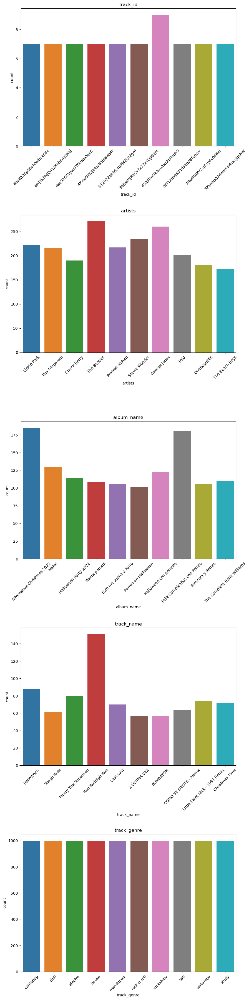

In [69]:
fig, ax = plt.subplots(nrows=len(cols_cat), ncols=1, figsize=(10,45))
fig.subplots_adjust(hspace=0.5)

for i, col in enumerate(cols_cat):
    top_10 = df_4[col].value_counts().nlargest(10)
    sns.countplot(x=col, data=df_4[df_4[col].isin(top_10.index)], ax=ax[i])
    ax[i].set_title(col)
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=45)

In [70]:
feature_numerical=[feature for feature in df_4.columns if df_4[feature].dtype!='O']
print('Number of numerical columns=', len(feature_numerical))
df_4[feature_numerical].head()

Number of numerical columns= 15


,popularity,duration,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,73,3.844433,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4
1,55,2.493500,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4
2,57,3.513767,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4
3,71,3.365550,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3
4,82,3.314217,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4


In [71]:
feature_discrete_numerical=[feature for feature in feature_numerical if df_4[feature].nunique()<50]
feature_discrete_numerical

['explicit', 'key', 'mode', 'time_signature']

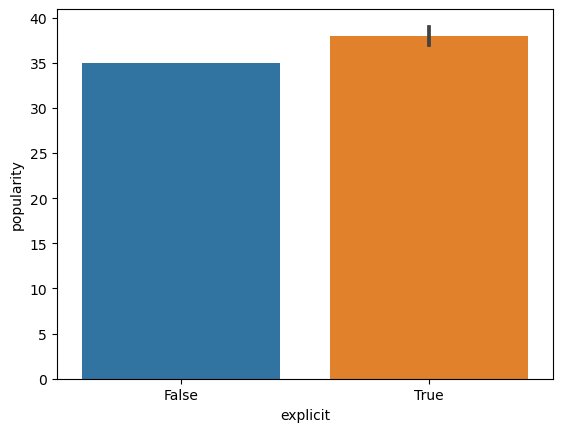

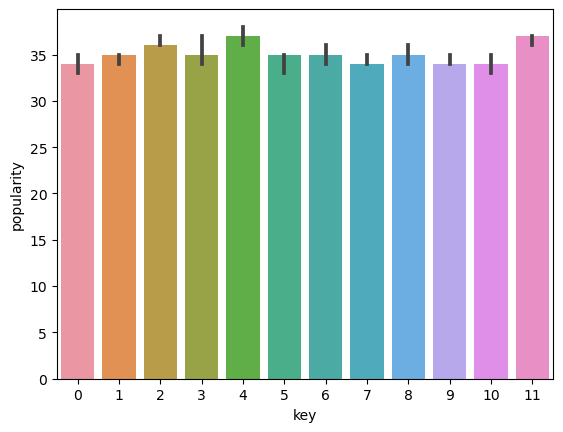

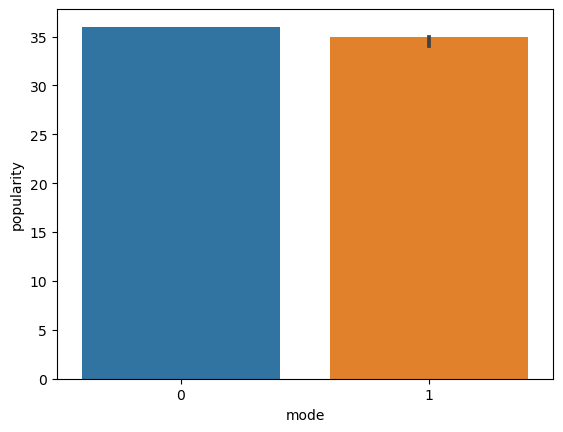

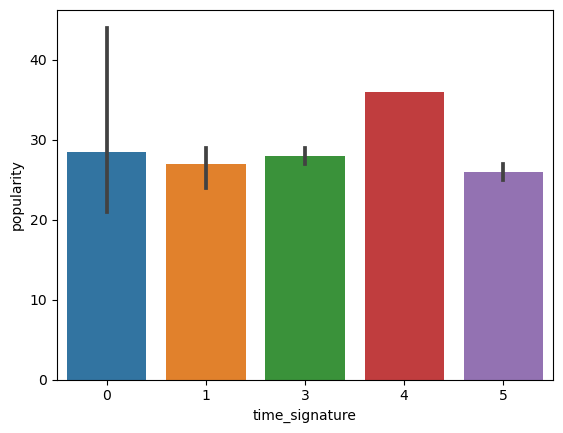

In [72]:
for feature in feature_discrete_numerical:
    dataset=df_4.copy()
    sns.barplot(x=feature, y=dataset['popularity'], data=dataset, estimator=np.median)
    plt.show()

### OBSERVACIONES:
- Se observa que las canciones que contienen letras explícitas son más populares en comparación con las canciones que no las contienen.
- La popularidad de canciones o pistas en diferentes claves, no afectan demasiado la popularidad. Las canciones en todas las tonalidades son casi igualmente populares. Las canciones en ambos modos son igualmente populares, tanto la mayor como la menor.
- El time signature es una convención de notación para especificar cuántos tiempos hay en cada compás. La firma de tiempo debe estar entre 3 y 7 según las firmas de tiempo del diccionario de datos de 3/4 a 7/4. Pero en este caso time_signature varía de 0 a 5. Se observa que las pistas que tienen time_signature 0 y 4 son más populares que otras.

In [73]:
features_continuous_numerical=[features for features in feature_numerical if features not in feature_discrete_numerical]

In [74]:
features_continuous_numerical

['popularity',
 'duration',
 'danceability',
 'energy',
 'loudness',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo']

In [75]:
from scipy.stats import skew

popularity skewness is : 0.025207994472057852


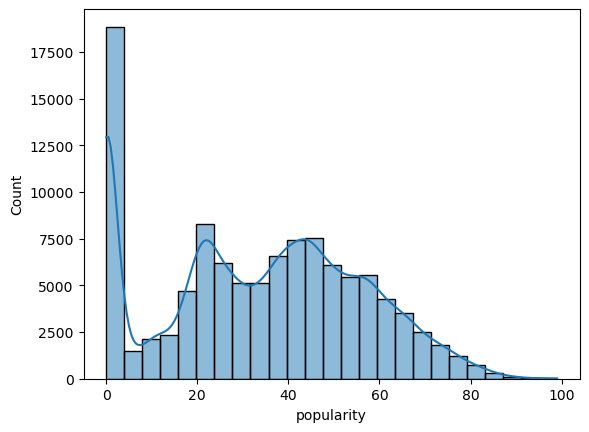

duration skewness is : 0.28966443416790283


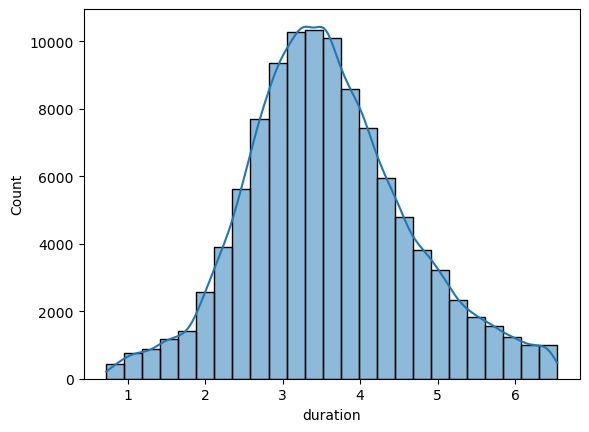

danceability skewness is : -0.31045650851308526


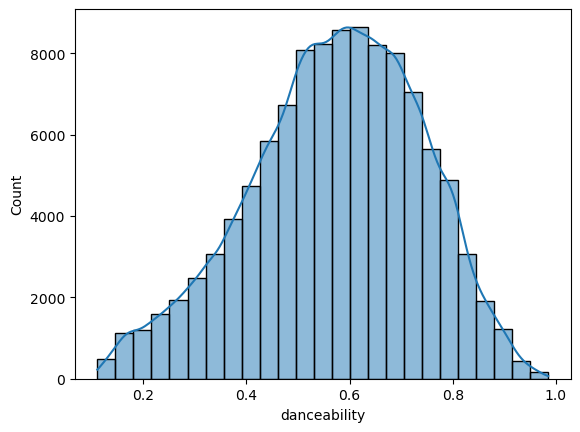

energy skewness is : -0.5928025634340353


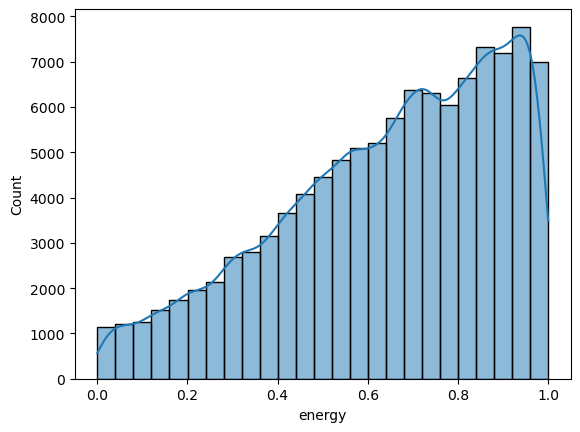

loudness skewness is : -2.0201354147731987


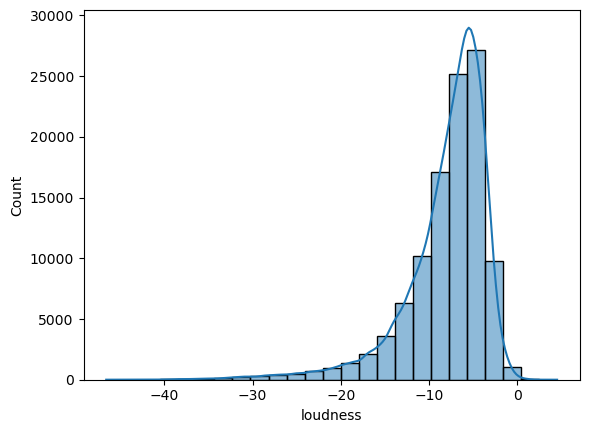

speechiness skewness is : 4.57857376940824


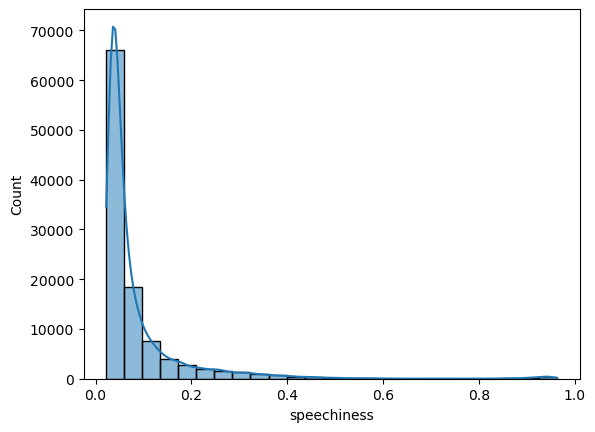

acousticness skewness is : 0.7211048843090915


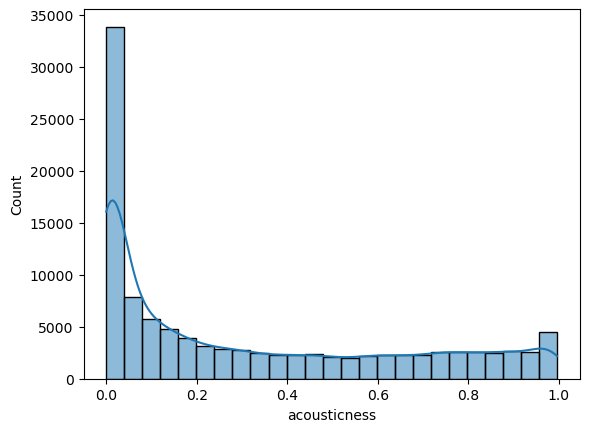

instrumentalness skewness is : 1.950914002194525


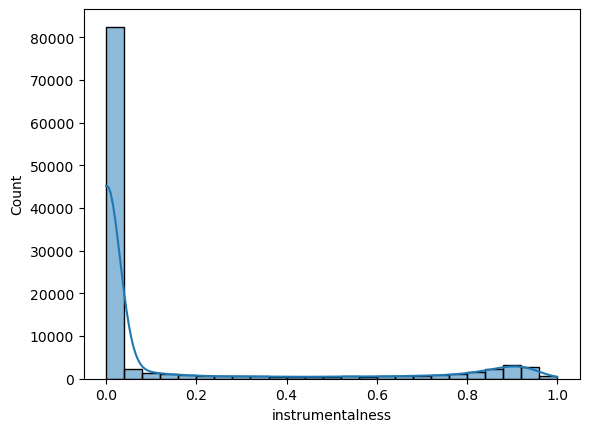

liveness skewness is : 2.1249193873573757


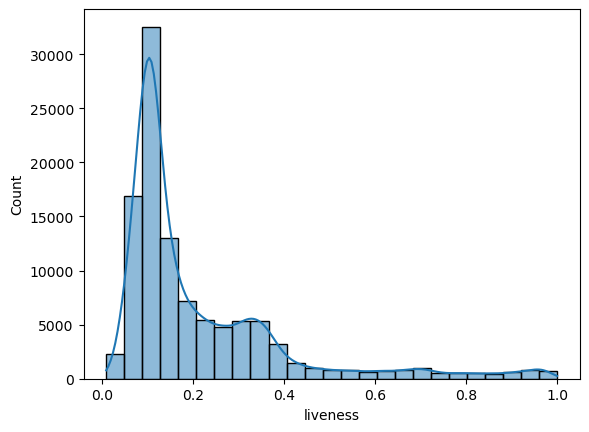

valence skewness is : 0.097665463352071


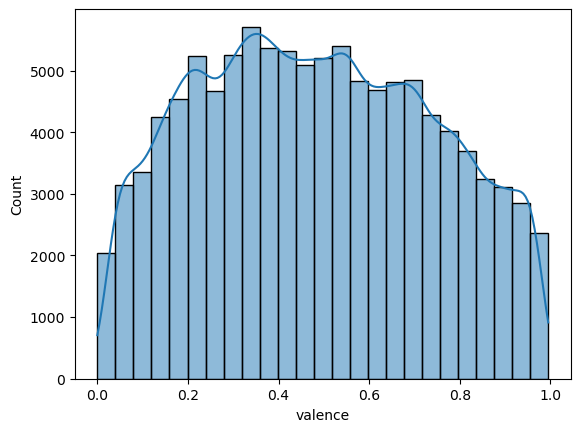

tempo skewness is : 0.3325443594548643


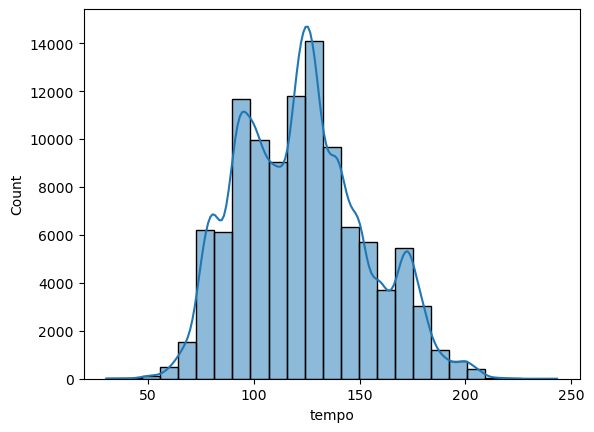

In [76]:
for feature in features_continuous_numerical:
    dataset=df_4.copy()
    print(feature, 'skewness is :', skew(dataset[feature]))
    sns.histplot(x=feature, data=dataset, bins=25, kde=True)
    plt.show()

### OBSERVACIONES

- Vemos que danceaility, valence y tempo tienen una distribución casi normal.
- Por su parte loudness tiene una distribución asimétrica hacia la izquierda.
- El resto tienen una distribución asimétrica hacia la derecha.

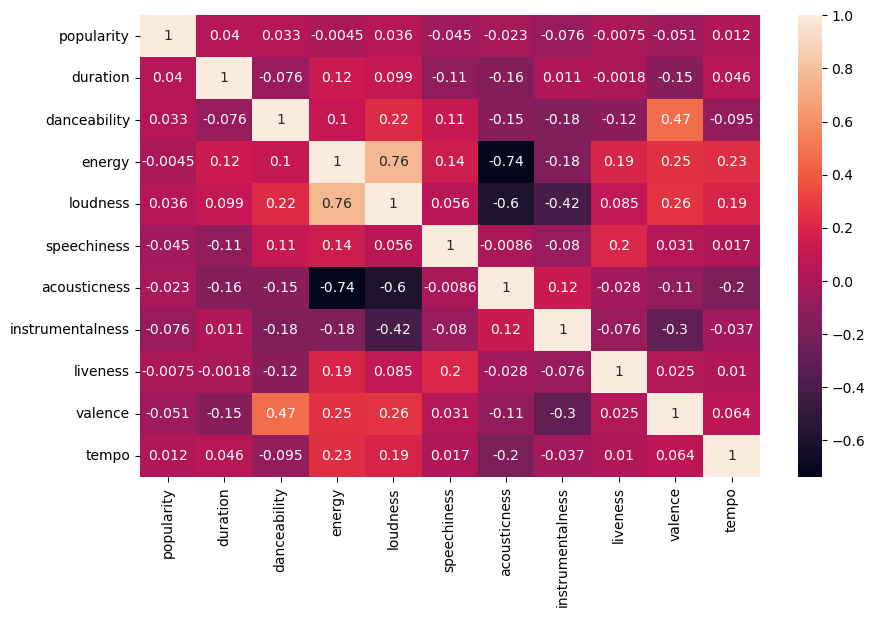

In [77]:
dataset=df_4.copy()
plt.figure(figsize=(10,6))
sns.heatmap(df_4[features_continuous_numerical].corr(), annot=True)
plt.show()

#### Se puede inferir que niguna de las variables continuas tiene una gran correlacion con la variable objetivo: popularity.
#### Se pueden hacer las transformaciones si se opta por un modelo de regresión. Los otros modelos como SVM, métodos basados en árboles, XG boost no requieren esas transformaciones.

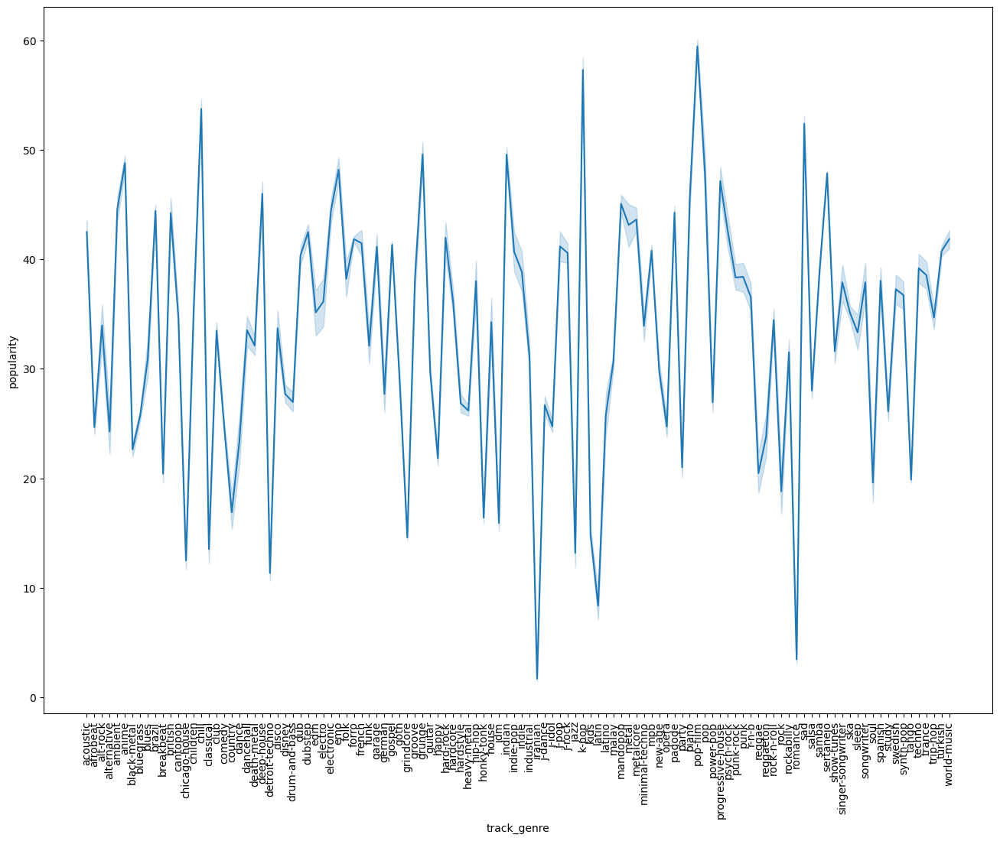

In [78]:
dataset=df_4.copy()
plt.figure(figsize=(16,12))
sns.lineplot(x='track_genre', y='popularity', data=dataset)
plt.xticks(rotation=90)
plt.show()

## FEATURE ENGINEERING

### Se buscará hacer lo siguiente:
- 1 Convertir la variable speechiness para representar la presencia de palabras habladas en una canción.
- 2 Remover la asimetría de la información para las variables numericas continuas usando un algoritmo de regresión.
- 3 Codificacion de las variables categoricas.
- 4 Estandarizar los valores de las variables que tengan el mismo rango.

### 1 Columna "speechiness":

La variable "speechiness" detecta de la presencia de palabras habladas en una canción.
Cuanto más parecida a la voz sea la grabación (por ejemplo, programa de entrevistas, audiolibro, poesía), más cerca de 1.0 será el valor del atributo.
Los valores superiores a 0.66 describen canciones que probablemente estén formadas en su totalidad por palabras habladas.
Los valores entre 0.33 y 0.66 describen pistas que pueden contener tanto música como voz, ya sea en secciones o en capas, incluidos casos como la música rap.
Los valores por debajo de 0.33 probablemente representen música y otras canciones que no sean de voz, es decir más instrumentales.

Entonces podemos convertir esta columna en características discretas. Voz alta, media y baja según el rango.

- Alto para valores superiores a 0.66
- Medio para valores entre 0.33 y 0.66
- Bajo para valores por debajo de 0.33

In [79]:
df_4['speechiness'].sort_values()


69239     0.0221
107904    0.0221
45959     0.0221
25465     0.0222
63831     0.0223
           ...  
18137     0.9620
18663     0.9620
18227     0.9620
18504     0.9630
18530     0.9630
Name: speechiness, Length: 107309, dtype: float64

Ahora se crea una nueva columna ára la variable speechiness la cual mostraría si la pista tiene un speechiness alto, medio o bajo.

In [80]:
speechiness_type=[]
for i in df_4.speechiness:
    if i<0.33:
        speechiness_type.append('Bajo')
    elif 0.33<=i<=0.66:
        speechiness_type.append('Medio')
    else:
        speechiness_type.append('Alto')

In [81]:
df_4['speechiness_type']=speechiness_type
print(df_4.speechiness_type.value_counts())
df_4.head()

Bajo     103914
Medio      2614
Alto        781
Name: speechiness_type, dtype: int64


,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,...,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,speechiness_type
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,3.844433,False,0.676,0.4610,1,...,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic,Bajo
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,2.493500,False,0.420,0.1660,1,...,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic,Bajo
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,3.513767,False,0.438,0.3590,0,...,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic,Bajo
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,3.365550,False,0.266,0.0596,0,...,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic,Bajo
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,3.314217,False,0.618,0.4430,2,...,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic,Bajo


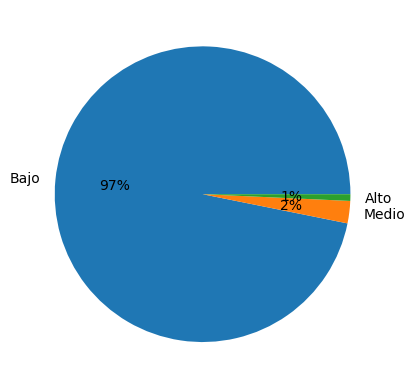

In [82]:
plt.pie(x=df_4['speechiness_type'].value_counts(),labels=df_4['speechiness_type'].unique(), autopct='%.0f%%')
plt.show()

Se observa que el 97% de las canciones tienen un bajo nivel de speechiness. Lo cual significa significa que la mayoria son canciones y no por ejemplo corresponientes a musica rap.

### Relación entre speechiness con popularity.

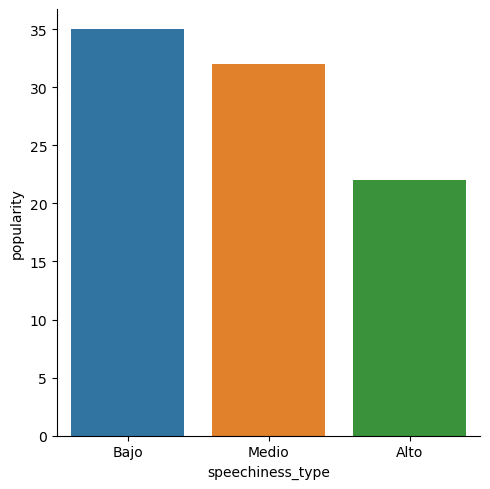

In [83]:
sns.catplot(data=df_4, x='speechiness_type', y='popularity', kind='bar', errorbar=None, estimator=np.median)
plt.show()

El promedio de la popularidad de las canciones con bajo speechiness es elevado, lo cual muestra que a la gente le gustan las canciones con mas melodia por sobre las mas habladas como el rap.

### 2 Asimetría:

Para los modelos de regresión se buscará transformar la información a una distribución de tipo gaussiana.

In [84]:
feature_numerical=[feature for feature in df_4.columns if df_4[feature].dtypes!='O']

In [85]:
feature_discrete_numerical=[feature for feature in feature_numerical if df_4[feature].nunique()<50]

In [86]:
feature_continuous_numerical=[feature for feature in feature_numerical if feature not in feature_discrete_numerical]
feature_continuous_numerical

['popularity',
 'duration',
 'danceability',
 'energy',
 'loudness',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo']

In [87]:
dataset_log=df_4.copy()
dataset_reci=df_4.copy()
dataset_sqrt=df_4.copy()
dataset_expo=df_4.copy()

In [88]:
from scipy import stats

In [89]:
for feature in feature_continuous_numerical:
    valid_values = dataset_log[feature] > 0  # Verificar si los valores son positivos
    dataset_log.loc[valid_values, feature] = np.log(dataset_log.loc[valid_values, feature] + 1)


In [90]:
for feature in feature_continuous_numerical:
    dataset_log[feature]=np.log(dataset_log[feature]+1)
    dataset_reci[feature]=1/(dataset_reci[feature]+1)
    dataset_sqrt[feature]=dataset_sqrt[feature]**(1/2)
    dataset_expo[feature]=dataset_expo[feature]**(1/5)

popularity original skewness: 0.025207994472057852
logarithmic: -1.6723967293855722
reciprocal:  1.8994201432486928
square-root: -0.841477205751808
exponential: -1.6216009733541235


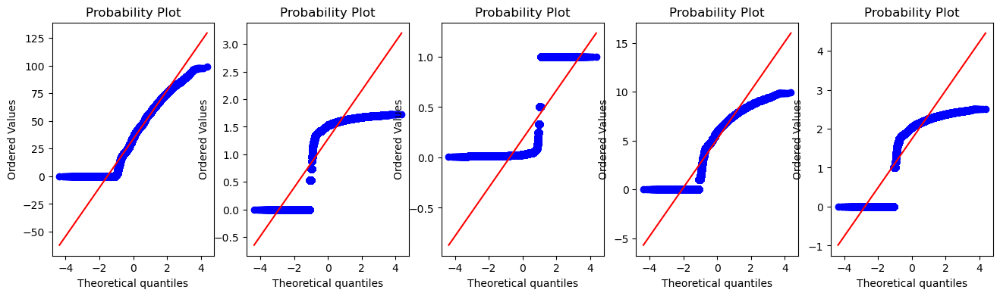

duration original skewness: 0.28966443416790283
logarithmic: -0.9513664484540048
reciprocal:  1.6072314756720645
square-root: -0.23304558933874128
exponential: -0.613662803940307


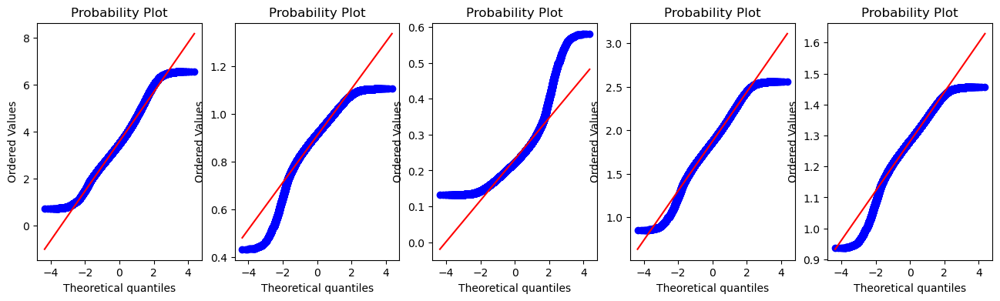

danceability original skewness: -0.31045650851308526
logarithmic: -0.7757651522719339
reciprocal:  0.8557095539705574
square-root: -0.7493691551628614
exponential: -1.0644905255233181


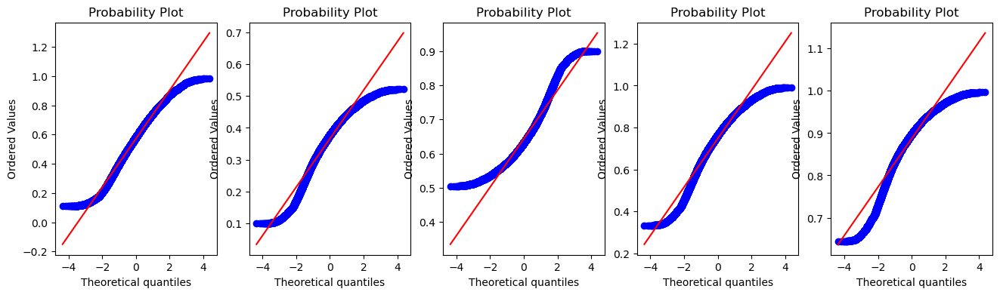

energy original skewness: -0.5928025634340353
logarithmic: -1.1320309553713208
reciprocal:  1.2243819247370327
square-root: -1.235045209081894
exponential: -2.004888595168576


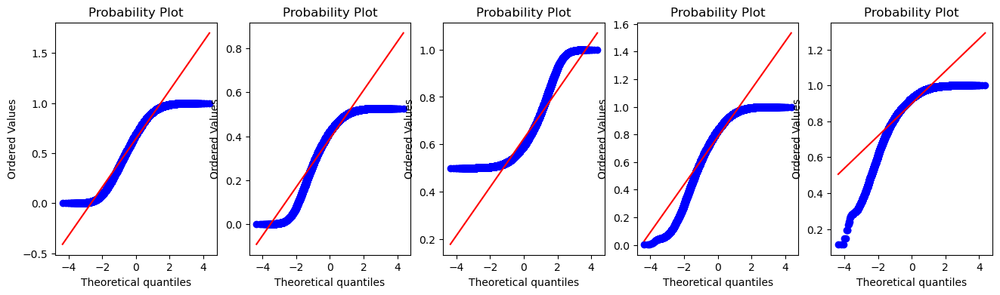

loudness original skewness: -2.0201354147731987
logarithmic: nan
reciprocal:  43.208927136316575
square-root: nan
exponential: nan


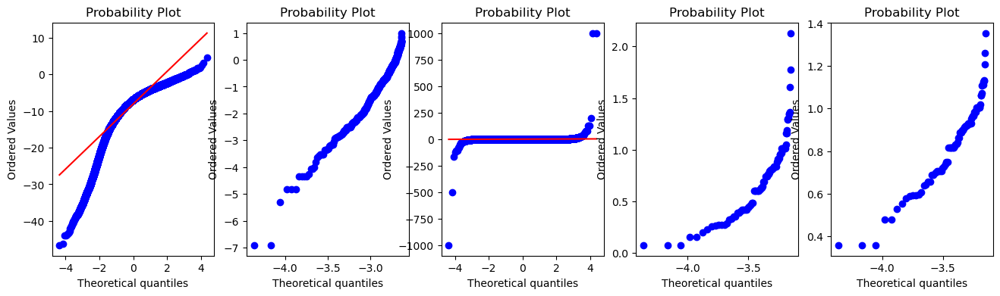

speechiness original skewness: 4.57857376940824
logarithmic: 3.0852027388540764
reciprocal:  -2.9626052814941897
square-root: 2.4823714386494267
exponential: 1.6677500363082236


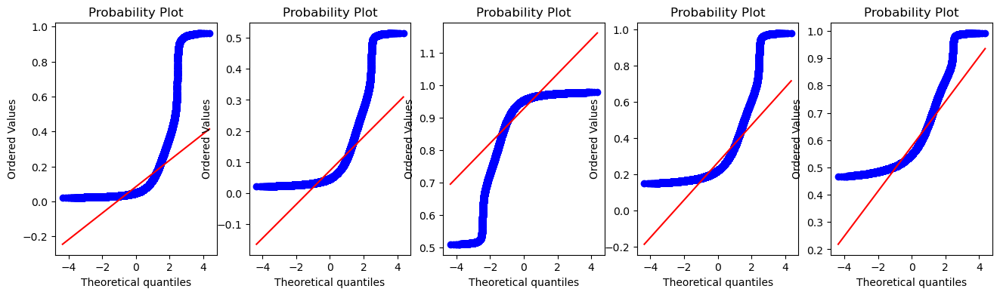

acousticness original skewness: 0.7211048843090915
logarithmic: 0.4121812444070671
reciprocal:  -0.37614782837012245
square-root: 0.17749024935352492
exponential: -0.4774512253536795


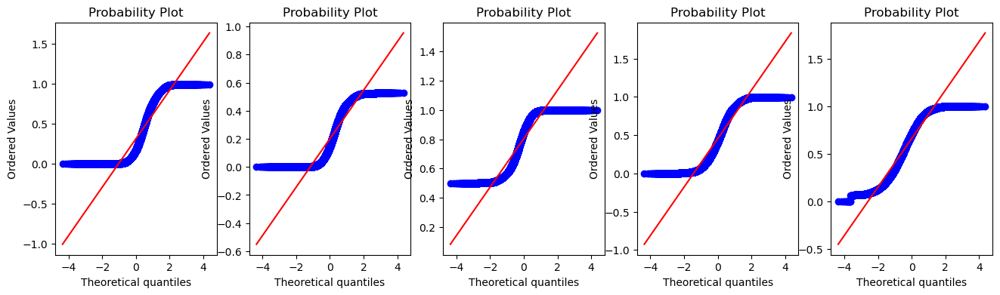

instrumentalness original skewness: 1.950914002194525
logarithmic: 1.7941012202890245
reciprocal:  -1.7763795631110553
square-root: 1.6276418012846645
exponential: 1.0502301374744034


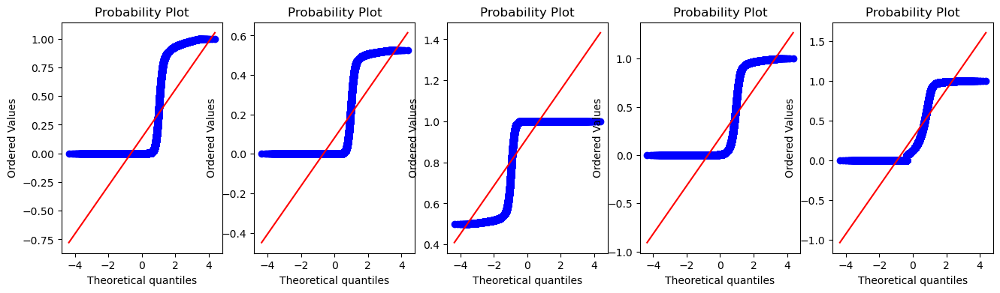

liveness original skewness: 2.1249193873573757
logarithmic: 1.4846662758811007
reciprocal:  -1.411678034326239
square-root: 1.3310705087720054
exponential: 0.85494069041486


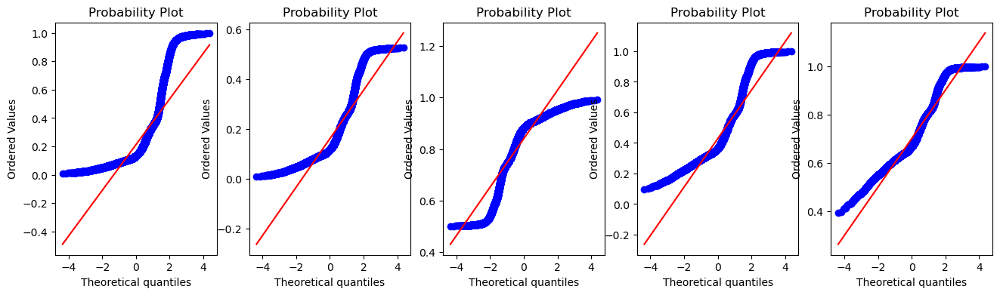

valence original skewness: 0.097665463352071
logarithmic: -0.3572544788581061
reciprocal:  0.42362647153638927
square-root: -0.45779423551227777
exponential: -1.091750625803317


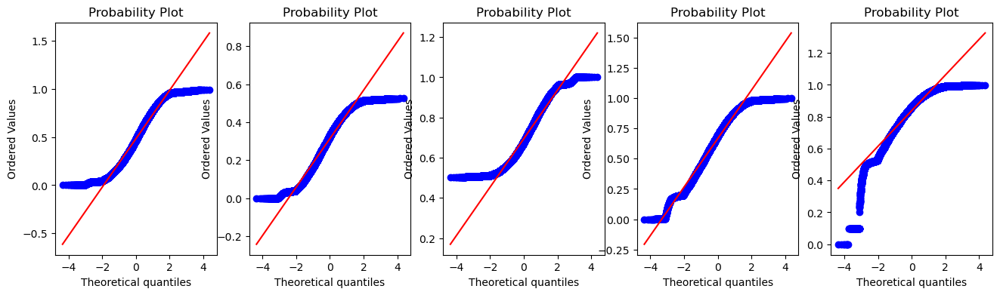

tempo original skewness: 0.3325443594548643
logarithmic: -0.3243759352191826
reciprocal:  0.9106035651831685
square-root: 0.062225615216503355
exponential: -0.10688530532050863


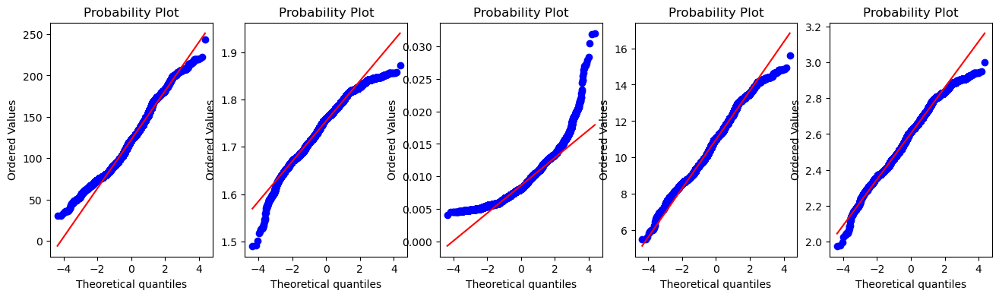

In [91]:
for feature in feature_continuous_numerical:
    plt.figure(figsize=(16,4))
    plt.subplot(1,5,1)
    print(feature, 'original skewness:', skew(df_4[feature]))
    stats.probplot(df_4[feature], dist='norm', plot=plt)
          
    plt.subplot(1,5,2)
    print('logarithmic:', skew(dataset_log[feature]))
    stats.probplot(dataset_log[feature], dist='norm', plot=plt)
          
    plt.subplot(1,5,3)
    print('reciprocal: ', skew(dataset_reci[feature]))
    stats.probplot(dataset_reci[feature], dist='norm', plot=plt)
    
    plt.subplot(1,5,4)
    print('square-root:', skew(dataset_sqrt[feature]))
    stats.probplot(dataset_sqrt[feature], dist='norm', plot=plt)
    
    plt.subplot(1,5,5)
    print('exponential:', skew(dataset_expo[feature]))
    stats.probplot(dataset_expo[feature], dist='norm', plot=plt)
    
    plt.show()

### OBSERVACIONES:
- Se observa ninguno de los metodos mejora realmente la asimetria para popularity, duration, danceability, energy, valence,tempo. Por lo cual funcionaria mejor si no se las transforma.
- En el caso de loudness, debido a que cuenta con valores negativos y ceros no parece ser buena alternativa la transformacion.
- La transformación exponencial le sentaría bien a speechiness, instrumentalness, liveness
- La transformación logaritmica le sentaría bien a acousticness
- La transformación raiz cuadrada le sentaría bien a tempo

Separación de la información para regresion y otros modelos.


In [92]:
df_4['tempo']=df_4['tempo']**(1/2)
df_4[['speechiness','instrumentalness','liveness']]=df_4[['speechiness','instrumentalness','liveness']]**(1/5)

In [93]:
df_4.head()


,track_id,artists,album_name,track_name,popularity,duration,explicit,danceability,energy,key,...,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,speechiness_type
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,3.844433,False,0.676,0.4610,1,...,0,0.677746,0.0322,0.063221,0.814285,0.715,9.376407,4,acoustic,Bajo
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,2.493500,False,0.420,0.1660,1,...,1,0.597730,0.9240,0.088923,0.632214,0.267,8.802784,4,acoustic,Bajo
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,3.513767,False,0.438,0.3590,0,...,1,0.561269,0.2100,0.000000,0.651084,0.120,8.736819,4,acoustic,Bajo
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,3.365550,False,0.266,0.0596,0,...,1,0.515206,0.9050,0.147871,0.666983,0.143,13.481098,3,acoustic,Bajo
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,3.314217,False,0.618,0.4430,2,...,1,0.554878,0.4690,0.000000,0.607730,0.167,10.952123,4,acoustic,Bajo


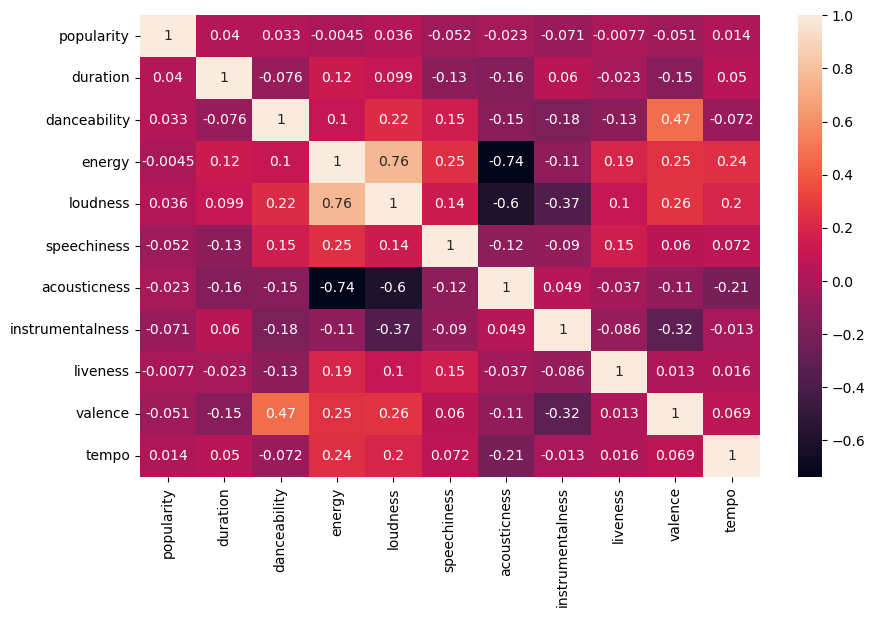

In [94]:
plt.figure(figsize=(10,6))
sns.heatmap(df_4[feature_continuous_numerical].corr(), annot=True)
plt.show()

### 3 Codificacion de las variables categoricas

In [95]:
feature_categorical=[feature for feature in df_4.columns if feature not in feature_numerical]

In [96]:
dataset=df_4.copy()
for feature in feature_categorical:
    print(feature,': {}, missing values {}'.format(df_4[feature].nunique(), df_4[feature].isna().sum()))

track_id : 84328, missing values 0
artists : 29970, missing values 0
album_name : 44387, missing values 0
track_name : 68943, missing values 0
track_genre : 114, missing values 0
speechiness_type : 3, missing values 0


OBSERVACIONES:
- La variable track_genre puede afectar la popularidad, ya que dependería del genero musical que le guste al individuo.
- El nombre del artista también puede afectar la popularidad de la canción, ya que es probable que un artista famoso tenga pistas más populares.
- track_name y album_name también pueden afectar la popularidad. Dado que hay una gran cantidad de entradas o valores unicos en cada una de estas columnas, se puede usar el codificador BaseN.
- speechiness_type se puede convertir con one-hot encoding.
- Como la cantidad de caracteristicas en track_genre es alta, podemos usar el método de codificación BaseN.

In [97]:
pip install category_encoders

Note: you may need to restart the kernel to use updated packages.


In [98]:
import category_encoders as ce

In [99]:
encoder1=ce.BaseNEncoder(cols=['track_genre','album_name', 'track_name','artists'], base=10, return_df=True)
df_4=encoder1.fit_transform(df_4)
df_4.head()

,track_id,artists_0,artists_1,artists_2,artists_3,artists_4,album_name_0,album_name_1,album_name_2,album_name_3,...,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre_0,track_genre_1,track_genre_2,speechiness_type
0,5SuOikwiRyPMVoIQDJUgSV,0,0,0,0,1,0,0,0,0,...,0.0322,0.063221,0.814285,0.715,9.376407,4,0,0,1,Bajo
1,4qPNDBW1i3p13qLCt0Ki3A,0,0,0,0,2,0,0,0,0,...,0.9240,0.088923,0.632214,0.267,8.802784,4,0,0,1,Bajo
2,1iJBSr7s7jYXzM8EGcbK5b,0,0,0,0,3,0,0,0,0,...,0.2100,0.000000,0.651084,0.120,8.736819,4,0,0,1,Bajo
3,6lfxq3CG4xtTiEg7opyCyx,0,0,0,0,4,0,0,0,0,...,0.9050,0.147871,0.666983,0.143,13.481098,3,0,0,1,Bajo
4,5vjLSffimiIP26QG5WcN2K,0,0,0,0,5,0,0,0,0,...,0.4690,0.000000,0.607730,0.167,10.952123,4,0,0,1,Bajo


In [100]:
df_4=pd.get_dummies(data=df_4, columns=['speechiness_type'], drop_first=True)
print(df_4.shape)
df_4.head()

(107309, 36)


,track_id,artists_0,artists_1,artists_2,artists_3,artists_4,album_name_0,album_name_1,album_name_2,album_name_3,...,instrumentalness,liveness,valence,tempo,time_signature,track_genre_0,track_genre_1,track_genre_2,speechiness_type_Bajo,speechiness_type_Medio
0,5SuOikwiRyPMVoIQDJUgSV,0,0,0,0,1,0,0,0,0,...,0.063221,0.814285,0.715,9.376407,4,0,0,1,1,0
1,4qPNDBW1i3p13qLCt0Ki3A,0,0,0,0,2,0,0,0,0,...,0.088923,0.632214,0.267,8.802784,4,0,0,1,1,0
2,1iJBSr7s7jYXzM8EGcbK5b,0,0,0,0,3,0,0,0,0,...,0.000000,0.651084,0.120,8.736819,4,0,0,1,1,0
3,6lfxq3CG4xtTiEg7opyCyx,0,0,0,0,4,0,0,0,0,...,0.147871,0.666983,0.143,13.481098,3,0,0,1,1,0
4,5vjLSffimiIP26QG5WcN2K,0,0,0,0,5,0,0,0,0,...,0.000000,0.607730,0.167,10.952123,4,0,0,1,1,0


## FEATURE SCALING

In [101]:
df_4['explicit']=np.where(df_4['explicit']==False, 0,1)


In [102]:
from sklearn.preprocessing import StandardScaler

In [103]:
scaler=StandardScaler()
features_scaling=[feature for feature in feature_numerical if feature not in ['popularity','mode']]
scaler.fit(df_4[features_scaling])

StandardScaler()

In [104]:
scaler.transform(df_4[features_scaling])

array([[ 0.25088919, -0.31147378,  0.62517887, ...,  0.9033663 ,
        -1.19520046,  0.21937929],
       [-1.02752866, -0.31147378, -0.91211681, ..., -0.84874327,
        -1.62165748,  0.21937929],
       [-0.06202793, -0.31147378, -0.8040257 , ..., -1.42365423,
        -1.67069883,  0.21937929],
       ...,
       [ 0.89438811, -0.31147378,  0.34294099, ...,  1.01287314,
         0.38771065,  0.21937929],
       [ 1.09038716, -0.31147378,  0.09072842, ..., -0.27774328,
         0.50266567,  0.21937929],
       [ 0.42690507, -0.31147378, -0.27558032, ...,  0.87598958,
        -1.5498837 ,  0.21937929]])

In [105]:
data_to_replace=pd.DataFrame(scaler.transform(df_4[features_scaling]), columns=features_scaling)

In [106]:
data_to_replace.head()


,duration,explicit,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,0.250889,-0.311474,0.625179,-0.739505,-1.211063,0.272132,1.119966,-0.858064,-0.636481,1.091015,0.903366,-1.195200,0.219379
1,-1.027529,-0.311474,-0.912117,-1.926280,-1.211063,-1.894026,0.230880,1.842657,-0.561995,-0.657852,-0.848743,-1.621657,0.219379
2,-0.062028,-0.311474,-0.804026,-1.149848,-1.492003,-0.344941,-0.174246,-0.319615,-0.819702,-0.476598,-1.423654,-1.670699,0.219379
3,-0.202289,-0.311474,-1.836896,-2.354324,-1.492003,-2.158367,-0.686059,1.785117,-0.391159,-0.323883,-1.333702,1.856411,-2.273618
4,-0.250866,-0.311474,0.276885,-0.811918,-0.930123,-0.333996,-0.245263,0.464738,-0.819702,-0.893030,-1.239839,-0.023742,0.219379


In [107]:
for feature in features_scaling:
    df_4[feature]=data_to_replace[feature].values

In [108]:
df_4.isna().sum()


track_id                  0
artists_0                 0
artists_1                 0
artists_2                 0
artists_3                 0
artists_4                 0
album_name_0              0
album_name_1              0
album_name_2              0
album_name_3              0
album_name_4              0
track_name_0              0
track_name_1              0
track_name_2              0
track_name_3              0
track_name_4              0
popularity                0
duration                  0
explicit                  0
danceability              0
energy                    0
key                       0
loudness                  0
mode                      0
speechiness               0
acousticness              0
instrumentalness          0
liveness                  0
valence                   0
tempo                     0
time_signature            0
track_genre_0             0
track_genre_1             0
track_genre_2             0
speechiness_type_Bajo     0
speechiness_type_Med

## FEATURE SELECTION

- Se usará correlacion para feature selection.
- Primero se hace la separación de variables dependientes e independientes.

In [109]:
X=df_4.drop(['popularity'], axis=1)
y=df_4['popularity']

In [110]:
X.head()


,track_id,artists_0,artists_1,artists_2,artists_3,artists_4,album_name_0,album_name_1,album_name_2,album_name_3,...,instrumentalness,liveness,valence,tempo,time_signature,track_genre_0,track_genre_1,track_genre_2,speechiness_type_Bajo,speechiness_type_Medio
0,5SuOikwiRyPMVoIQDJUgSV,0,0,0,0,1,0,0,0,0,...,-0.636481,1.091015,0.903366,-1.195200,0.219379,0,0,1,1,0
1,4qPNDBW1i3p13qLCt0Ki3A,0,0,0,0,2,0,0,0,0,...,-0.561995,-0.657852,-0.848743,-1.621657,0.219379,0,0,1,1,0
2,1iJBSr7s7jYXzM8EGcbK5b,0,0,0,0,3,0,0,0,0,...,-0.819702,-0.476598,-1.423654,-1.670699,0.219379,0,0,1,1,0
3,6lfxq3CG4xtTiEg7opyCyx,0,0,0,0,4,0,0,0,0,...,-0.391159,-0.323883,-1.333702,1.856411,-2.273618,0,0,1,1,0
4,5vjLSffimiIP26QG5WcN2K,0,0,0,0,5,0,0,0,0,...,-0.819702,-0.893030,-1.239839,-0.023742,0.219379,0,0,1,1,0


In [111]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test=train_test_split(X,y, test_size=0.3, random_state=7)

In [112]:
print(X_train.shape, X_test.shape)
print(y_train.shape, y_test.shape)

(75116, 35) (32193, 35)
(75116,) (32193,)


In [113]:
def correlation(dataset,threshold):
    correlated_columns=set()
    correlation_matrix=dataset.corr()
    for i in range(len(correlation_matrix.columns)):
        for j in range(i):
            if abs(correlation_matrix.iloc[i,j])>threshold:
                colname=correlation_matrix.columns[i]
                correlated_columns.add(colname)
    return correlated_columns

In [114]:
corr_features=correlation(X_train,0.7)
print(len(set(corr_features)))
print(corr_features)

5
{'acousticness', 'album_name_0', 'loudness', 'track_name_0', 'speechiness_type_Medio'}


In [115]:
X_train_corr=X_train.copy()
X_test_corr=X_test.copy()

In [116]:
X_train_corr.drop(corr_features, axis=1, inplace=True)
X_test_corr.drop(corr_features, axis=1, inplace=True)
print(X_train_corr.shape, X_test_corr.shape)

(75116, 30) (32193, 30)


In [117]:
X_train_corr.isna().sum()

track_id                 0
artists_0                0
artists_1                0
artists_2                0
artists_3                0
artists_4                0
album_name_1             0
album_name_2             0
album_name_3             0
album_name_4             0
track_name_1             0
track_name_2             0
track_name_3             0
track_name_4             0
duration                 0
explicit                 0
danceability             0
energy                   0
key                      0
mode                     0
speechiness              0
instrumentalness         0
liveness                 0
valence                  0
tempo                    0
time_signature           0
track_genre_0            0
track_genre_1            0
track_genre_2            0
speechiness_type_Bajo    0
dtype: int64

## ENTRENAMIENTO DE MODELO

In [131]:
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import BayesianRidge
from xgboost import XGBRegressor, XGBRFRegressor

In [132]:
lr=LinearRegression()
lasso=Lasso()
ridge=Ridge()
xgbreg=XGBRegressor()
xgbrfreg=XGBRFRegressor()
dtree=DecisionTreeRegressor()
bayridge=BayesianRidge()

In [133]:
def model(name):
    name.fit(X_train_corr,y_train)
    prediction=name.predict(X_test_corr)
    residual=y_test-prediction
    
    plt.figure(figsize=(15,6))
    
    plt.subplot(1,2,1)
    plt.scatter(y_test,prediction)
    
    plt.subplot(1,2,2)
    sns.distplot(residual, hist=False, kde=True)
    plt.show()

In [134]:
import warnings
warnings.filterwarnings("ignore")

In [135]:
model(lr)


ValueError: could not convert string to float: '1kvkYrjZh561EJwERr8EsK'

In [136]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score

In [137]:
algos=[lr, lasso, ridge, xgbreg, xgbrfreg, dtree, bayridge]
MSE=[]
ABMSE=[]
R2_score=[]
for feature in algos:
    prediction=feature.predict(X_test_corr)
    mse=mean_squared_error(y_test, prediction)
    abmse=mean_absolute_error(y_test, prediction)
    score=r2_score(y_test, prediction)
    MSE.append(mse)
    ABMSE.append(abmse)
    R2_score.append(score)

ValueError: could not convert string to float: '0IVliQIAr5Mj7HL15m5tpp'